# Face Emotion Detection

## ML 6140 Final Project

<b><u>Team 1: </u></b>Anuja Prakash Kolse, Saideep Samineni, Aishwarya Kumar Arvind, Rohith Chandra Kandambeth

Prof. Uzair Ahmad

Spring 2024

In today's digital age, recognizing human emotions from facial expressions is crucial, especially
for enhancing communication, empathy, and human-computer interaction. This project aims to
create a machine learning (ML) model that can detect and classify emotions from facial images.
It involves identifying key facial features and linking them to emotions like happiness, sadness,
anger, and more. The challenge is to accurately recognize these emotions in different facial
structures and conditions. The model's applications include improving user interaction with
computers, aiding mental health diagnosis, enhancing customer service, and personalizing
content in entertainment. The goal is to develop an efficient model using advanced ML
techniques for accurate emotion detection, evaluated by its accuracy and adaptability. This
project seeks to advance the understanding and use of emotion recognition technology in
real-world settings.

## How to Run Code
To run the code, simply follow these steps:

1. Download Dataset - https://www.kaggle.com/datasets/jonathanoheix/face-expression-recognition-dataset
2. Make sure you replace all the directory and file paths.
3. Ensure all dependencies are installed (see Section 0 on Imports).

## 0.  Imports

In [33]:
import os
import numpy as np 
import cv2
from keras_facenet import FaceNet
from sklearn import svm
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from deepface import DeepFace
from sklearn.neural_network import MLPClassifier
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc, roc_auc_score
import warnings
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import label_binarize
import matplotlib.image as mpimg

In [2]:
pd.set_option('display.max_columns', None)
sns.set_style('darkgrid')
warnings.filterwarnings('ignore')

In [ ]:
#This does not generate the reps when set to 0, uses the saved features  
generate_reps = 0

## 1. Create labels file from the given dataset

We have downloaded the dataset from https://www.kaggle.com/datasets/ananthu017/emotion-detection-fer. The dataset contain 35,685 examples of 48x48 pixel gray scale images of faces divided into train and test dataset. Images are categorized based on the emotion shown in the facial expressions (happiness, neutral, sadness, anger, surprise, disgust, fear).

The dataset is stored under a directory named "archive" within separate "train" and "test" folders. The use of folder names as labels in the labels file is done because each folder within the "train" and "test" directories corresponds to a different class or category of images which are emotions.

<b><u>Emotion classes: </u></b>
1. Happy 
2. Angry
3. Disgusted
4. Fearful
5. Happy
6. Neutral
7. Sad

In [87]:
dir_train = "/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/train"
write_file_train = 'labels_train.txt'
dir_test = "/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/test"
write_file_test = 'labels_test.txt'

In [ ]:
def create_labels(arg_dir, write_file):
    """
    Purpose: This function creates labels using the folder structure
    :param arg_dir: str Folder where all images are stored
    :param write_file: str File where the labels will be written
    """
    folder_names = os.listdir(arg_dir)
    # folder_names_train.remove('.DS_Store')
    labels_file = open(write_file, 'w')
    for each_folder in folder_names_train:
        current_folder_list = os.listdir(os.path.join(arg_dir, each_folder))
        for each_file in current_folder_list:
            labels_file.write(os.path.join(arg_dir, each_folder, each_file))
            labels_file.write(", "+ each_folder + "\n")
    labels_file.close()

In [ ]:
create_labels(dir_train, write_file_train)
create_labels(dir_test, write_file_test)

In [88]:
def print_head_file(filepath, num_lines):
    """
    Purpose: This functions prints first n lines of the given input file 
    :param filepath: str Filename
    :param num_lines: int Number of lines to be printed
    """
    fi = open(filepath, "r").read().splitlines()
    for i in range(num_lines):
        print(fi[i])
    print("No. of lines: ", len(fi))

In [89]:
print("Training labels file: ")
print_head_file(write_file_train, 5)
print("Testing labels file: ")
print_head_file(write_file_test, 5)

Training labels file: 
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/train/happy/im4403.png, happy
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/train/happy/im2072.png, happy
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/train/happy/im6214.png, happy
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/train/happy/im771.png, happy
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/train/happy/im6572.png, happy
No. of lines:  28709
Testing labels file: 
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/test/happy/im771.png, happy
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/test/happy/im765.png, happy
/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/archive/test/happy/im1209.png, happy
/Users/anujaprakashkolse/Dow

## 2. Facenet reps

<b>Facenet</b> 

(https://www.cv-foundation.org/openaccess/content_cvpr_2015/papers/Schroff_FaceNet_A_Unified_2015_CVPR_paper.pdf)

Facenet is a neural network architecture that effectively models the identity of faces. Developed by researchers at Google, it's primarily used for face verification, recognition, and clustering. The "embeddings" produced by Facenet are compact numerical representations of facial features extracted from images.

<b>How Facenet Works</b>

Facenet takes an input image of a face and processes it through a deep convolutional neural network to generate an output vector known as an "embedding" or a "feature vector". These embeddings are designed such that the Euclidean distance between the embeddings of two different images reflects the face similarity. In other words, images of the same person have embeddings that are closer to each other, and images of different people have embeddings that are more distant.

<b>Characteristics of Facenet Embeddings</b>

1. Dimensionality: The embeddings are typically vectors of a fixed size (e.g., 128 dimensions) that represent the most significant features of the face irrespective of any variations in lighting, facial expressions, or angles from which the photo is taken.
2. Training: Facenet is trained using a triplet loss function. In this approach, during each training step, the model looks at three images: an anchor (a base image of one person's face), a positive (another image of the same person’s face), and a negative (an image of a different person's face). The goal is to make the distance between the anchor and the positive less than the distance between the anchor and the negative by some margin, effectively training the model to pull the embeddings of the same identities closer while pushing the embeddings of different identities apart.

We use a pre-trained facenet model and use it to generate embeddings for the faces from our dataset. 

### 2.1 Feature reps generation 

In [ ]:
#Create FaceNet class object 
embedder = FaceNet()

In [ ]:
def create_embeddings(labels_file, csv_file):
    """
    Purpose: This function creates embeddings and writes them to a file
    :param labels_file: str File name with labels
    :param csv_file: str File name of output file 
    """
    for line in labels_file:
        split_arr = line.split(",")
        img_path = split_arr[0]
        label = split_arr[1]
        img = cv2.imread(img_path)
        embeddings = embedder.embeddings([img])
        for i in range(len(embeddings[0])):
            if (i == len(embeddings[0])-1):
                csv_file.write("{} , {}\n".format(embeddings[0][i], label))
            else:
                csv_file.write("{} , ".format(embeddings[0][i]))
    csv_file.close()  

In [90]:
train_facenet = "train.csv"
test_facenet = "test.csv"

In [ ]:
if generate_reps:
    csv_file_train = open(train_facenet, "w")
    csv_file_test = open(test_facenet, "w")
    
labels_file_train = open("/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/labels_train.txt", "r").read().splitlines()
labels_file_test = open("/Users/anujaprakashkolse/Downloads/NEU/Semesters/Spring_24/Anuja_ML/Project/labels_test.txt", "r").read().splitlines()

In [ ]:
if generate_reps:
    create_embeddings(labels_file_train, csv_file_train)
    create_embeddings(labels_file_test, csv_file_test)

In [91]:
print("Training facenet reps file: ")
print_head_file(train_facenet, 1)
print("Testing facenet reps file: ")
print_head_file(test_facenet, 1)

Training facenet reps file: 
-0.09191915392875671 , 0.05191560089588165 , 0.001943407580256462 , -0.027426280081272125 , -0.048226114362478256 , -0.03152553737163544 , 0.03589266911149025 , 0.0015046955086290836 , 0.021026508882641792 , 0.045596200972795486 , 0.053746286779642105 , 0.0010737429838627577 , 0.034575507044792175 , 0.02408357709646225 , -0.04162553325295448 , -0.018272148445248604 , -0.05154378339648247 , 0.000988357118330896 , -0.08532267808914185 , -0.002191742416471243 , -0.012119043618440628 , 0.06869334727525711 , 0.05618792399764061 , -0.00855319295078516 , -0.0072304257191717625 , -0.00391199067234993 , -0.07025182992219925 , -0.06764562427997589 , -0.03693681210279465 , -0.005992091726511717 , 0.010336516425013542 , 0.04580238461494446 , 0.03632519021630287 , -0.058822352439165115 , 0.07862319052219391 , 0.0968177318572998 , 0.06346937268972397 , -0.08291857689619064 , 0.06903493404388428 , 0.010136095806956291 , -0.024404726922512054 , -0.02354368008673191 , 0.055

In [4]:
df_train_fn = pd.read_csv(train_facenet, header=None)
df_train_fn.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512
0,-0.091919,0.051916,0.001943,-0.027426,-0.048226,-0.031526,0.035893,0.001505,0.021027,0.045596,0.053746,0.001074,0.034576,0.024084,-0.041626,-0.018272,-0.051544,0.000988,-0.085323,-0.002192,-0.012119,0.068693,0.056188,-0.008553,-0.007230,-0.003912,-0.070252,-0.067646,-0.036937,-0.005992,0.010337,0.045802,0.036325,-0.058822,0.078623,0.096818,0.063469,-0.082919,0.069035,0.010136,-0.024405,-0.023544,0.055060,-0.047308,0.013607,0.027601,-0.023596,0.060026,0.010083,0.017034,0.038647,-0.068586,-0.048364,0.024405,0.051433,-0.049282,-0.021404,-0.024520,-0.063397,0.013782,0.030878,0.019513,0.007491,-0.011460,-0.063794,-0.057241,0.026620,0.044420,0.087946,0.041435,0.095808,-0.007067,-0.007141,0.001577,-0.030422,-0.041289,0.041405,0.035168,-0.002566,0.009202,-0.003668,0.018404,0.018741,-0.070165,-0.056671,-0.006913,0.027182,-0.069503,0.033479,-0.052945,-0.001366,0.033672,-0.019232,-0.038469,0.019043,0.071979,-0.024866,-0.054106,-0.028522,0.060951,-0.016885,0.025282,0.037376,-0.020096,-0.055832,0.029264,0.004245,-0.001238,-0.034572,-0.034511,0.040442,-0.003826,0.129863,0.011523,0.020725,-0.024900,0.017243,0.014650,-0.032190,-0.056024,0.003800,-0.015897,0.024585,0.019538,-0.013540,0.002972,-0.156469,0.062749,-0.006227,-0.010606,0.078806,-0.054385,-0.092046,-0.026203,0.034468,0.040944,-0.029559,0.016964,0.020554,0.023982,-0.037383,-0.018018,0.005501,-0.051857,-0.047178,0.094996,0.003335,0.014330,-0.040099,-0.004827,-0.016216,-0.037479,-0.057822,-0.002180,0.016853,-0.007307,0.004680,0.010113,-0.069212,-0.032507,-0.031027,0.019986,-0.017194,-0.043413,0.057155,-0.076191,0.031233,0.002322,-0.026758,-0.052874,-0.091505,-0.034992,-0.013125,0.044584,0.002641,-0.057023,0.014487,-0.009713,-0.006230,-0.015235,-0.062692,0.000580,0.058601,-0.041919,-0.047219,-0.012597,0.036943,-0.076175,-0.035681,-0.010585,-0.016373,0.003178,0.058654,0.076596,-0.036219,-0.038270,0.002290,-0.027249,0.022010,-0.017989,-0.096854,0.015711,-0.006661,0.038081,0.031362,-0.044270,0.033680,-0.037578,-0.071015,-0.029237,0.022966,0.027945,-0.016642,-0.022438,0.011286,0.0309

In [5]:
# Label encoder to get classes in form of integer
le = LabelEncoder()
X_train_fn = df_train_fn.iloc[:, :-1].to_numpy()  # Features
y_train_fn = le.fit_transform(df_train_fn.iloc[:, -1]) # Target

label_mapping = dict(zip(le.classes_, range(len(le.classes_))))
print("The mapping of labels is as follows: \n", label_mapping)

The mapping of labels is as follows: 
 {'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


### 2.2 Data transfomation (PCA)

In [6]:
scaler = StandardScaler()

# Fitting the scaler on training data and transforming train and test sets
X_train_scaled = scaler.fit_transform(X_train_fn)

# Prinicipal Component Analysis for analysis
pca = PCA()
pca.fit_transform(X_train_scaled)

array([[-6.01058081e+00,  3.16705724e+00,  1.14699403e+00, ...,
         6.05847176e-04, -3.83088782e-05,  1.27947505e-04],
       [-1.38976974e+00, -7.07354689e-01,  3.03754648e+00, ...,
        -8.21537110e-04, -3.07547905e-04,  2.00969582e-05],
       [ 1.29553489e+01, -2.35950711e+00,  1.61104791e+00, ...,
         3.86332329e-04, -1.00379165e-04, -6.61372923e-04],
       ...,
       [-3.47880694e+00, -5.42636784e-01, -4.56797820e+00, ...,
        -1.68344937e-04, -3.55834762e-04,  4.32686323e-04],
       [ 1.37045743e+01, -1.73170484e+00,  1.12220622e+00, ...,
         4.05756577e-04, -2.71784696e-04,  4.91048414e-04],
       [-3.03118744e+00,  6.51368045e+00,  2.41581294e+00, ...,
         8.80925142e-05, -3.05626404e-04,  3.85298940e-05]])

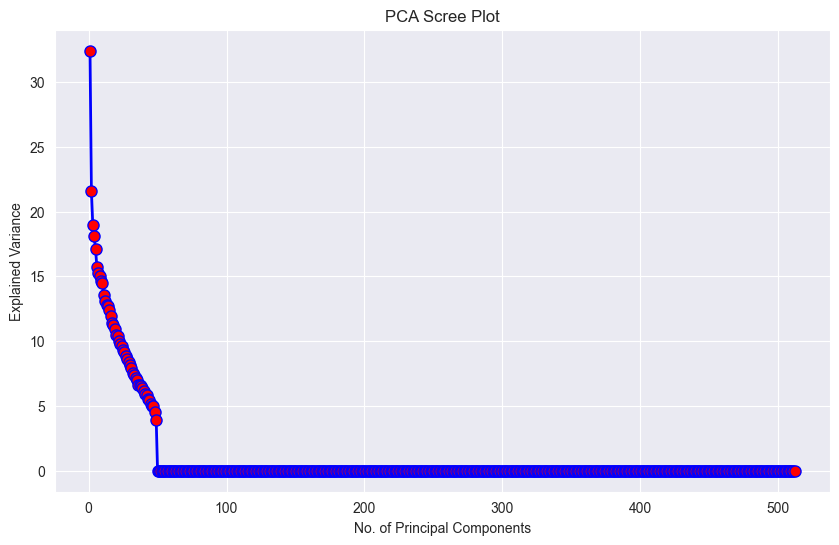

In [7]:
explained_variance = pca.explained_variance_
variance_ratios = pca.explained_variance_ratio_

# Generating a scree plot to visualize the significance of each principal component
plt.figure(figsize=(10, 6))
plt.plot(np.arange(1, 1 + len(explained_variance)), explained_variance, 
         marker='o', linestyle='-', color='b', markerfacecolor='red', markersize=8, linewidth=2)
plt.title('PCA Scree Plot')
plt.xlabel('No. of Principal Components')
plt.ylabel('Explained Variance')
plt.grid(True)
plt.show()

<b>Observations:</b>
1. Explained Variance: The plot shows the explained variance by each principal component. It's evident that the first few components explain the most variance within the dataset. This is typical in PCA, where the initial components capture the majority of the information.

2. Elbow Method: There is a clear "elbow" in the plot, which is the point after which the marginal gain in explained variance drops significantly. In this plot, the elbow seems to occur around the 5th component. This suggests that selecting the first 5 principal components may be sufficient for capturing most of the information without much loss of data.

3. Dimensionality Reduction: Given that the explained variance becomes minimal after about the 20th component, one could significantly reduce the dataset's dimensionality without losing much explanatory power. The components beyond this point contribute increasingly less to the total variance.

4. Redundant Features: The fact that only a small number of components are needed to explain a significant portion of variance suggests that the original dataset might have redundant features or features that do not contribute significantly to the dataset's variability.

5. Potential Overfitting Reduction: By using only the principal components with the most explanatory power (such as the first 50), one can potentially reduce overfitting when these components are used in subsequent machine learning models.

## 3. SVM Training for facenet reps

<b><u>Support Vector Machine (SVM)</u></b> is a powerful and versatile supervised machine learning model, capable of performing linear or nonlinear classification, regression, and even outlier detection. It is well-suited for classification of complex but small- or medium-sized datasets.

<b><u>Training SVM:</u></b>
When training an SVM, the goal is to find the optimal hyperplane that best divides or separates the classes in the feature space. In a two-dimensional space, this hyperplane is a line dividing a plane in two parts where in each class lay in either side.

Here's a brief on how SVM works and its parameters:

1. <u>Choosing the Kernel:</u> The kernel function is used to transform the input data into a higher-dimensional space where a hyperplane can be used to separate classes that are not linearly separable in the original space. Common kernels include: linear, poly, rbf (Radial basis function), sigmoid 

2. <u>Regularization (C):</u> The C parameter trades off correct classification of training examples against maximization of the decision function's margin. A low C makes the decision surface smooth, while a high C aims at classifying all training examples correctly by giving the model freedom to select more samples as support vectors.

3. <u>Gamma (γ):</u> For non-linear kernels, this parameter defines how far the influence of a single training example reaches, with low values meaning ‘far’ and high values meaning ‘close’. The γ parameter can be seen as the inverse of the radius of influence of samples selected by the model as support vectors.

4. <u>Margin and Support Vectors:</u> During training, SVM finds the margin that separates the classes best. The support vectors are the data points that lie closest to the decision surface (or hyperplane), and they are the most difficult to classify. They have a direct bearing on the optimum location of the decision boundary.

5. <u>Hinge Loss Function:</u> SVM uses the hinge loss function to compute the error. This loss function is used to maximize the margin and minimize the misclassification.

6. <u>Soft Margin Classification:</u> In cases where the data is not linearly separable, SVM introduces the slack variable ξ to allow misclassification of difficult or noisy instances to achieve a soft margin that allows some misclassifications.

### 3.1 Hyperparameter tuning

This section contains the code for hyperparameter tuning. As the hyperparameter tuning with cross validation takes a long time to run, we have used separate notebooks to run this code. This code is present only for reference and not actually run. 

The final best parameters that we found for SVM with FaceNet reps are:
<b><u>C = 10,
gamma = 1,
kernel = 'rbf' </u></b>

In [ ]:
# Define the model
clf_fn = svm.SVC()

# Define the parameter grid
param_grid = {
    'C': [0.1, 1, 10, 100, 1000],
    'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
    'kernel': ['linear', 'poly', 'rbf']
}

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=clf_fn, param_grid=param_grid, cv=5, verbose=2, scoring='accuracy')

# Fit GridSearchCV
grid_search.fit(X_train_fn, y_train_fn)

# Print the best parameters and the best score
print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score: {:.2f}".format(grid_search.best_score_))

In [8]:
clf_fn = svm.SVC(C=10, gamma=1, kernel='rbf', probability=True)
clf_fn.fit(X_train_fn, y_train_fn)

SVC(C=10, gamma=1, probability=True)

In [9]:
clf_fn_wo = svm.SVC(C=10, gamma=1, kernel='rbf')
clf_fn_wo.fit(X_train_fn, y_train_fn)

SVC(C=10, gamma=1)

In [23]:
y_train_predicted_fn = clf_fn_wo.predict(X_train_fn)

In [12]:
df_test_fn = pd.read_csv(test_facenet, header=None)
df_test_fn.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512
0,-0.026437,0.071417,0.092250,-0.020436,0.068914,-0.085590,-0.047277,-0.022069,-0.015329,0.012672,0.027879,-0.063345,-0.066495,-0.013334,0.062050,-0.043401,-0.046964,0.106017,-0.072095,0.026274,0.063629,0.060516,-0.006067,0.018913,-0.106894,0.053805,0.046286,0.052372,-0.009126,-0.025225,-0.045286,0.022133,0.074842,-0.056186,0.063175,0.001818,0.039019,0.057232,0.044370,-0.022556,-0.041778,0.009504,0.016900,-0.024666,-0.004369,-0.025666,-0.021540,0.002698,-0.053857,0.042818,-0.038715,0.000751,-0.066550,-0.031652,0.071109,-0.007927,0.028171,-0.022794,0.027969,-0.004834,-0.053130,-0.019626,-0.007396,-0.066443,-0.003650,-0.078379,-0.046249,0.046962,-0.015702,0.026992,0.059914,-0.006187,-0.018720,-0.083210,0.044864,-0.046492,0.036620,0.049398,-0.032715,-0.054796,-0.020089,0.043430,0.092974,-0.036003,-0.066448,-0.037764,0.004873,0.011612,-0.013633,-0.023314,-0.089999,0.015965,-0.000811,0.023370,-0.042833,-0.039284,-0.049462,-0.008074,0.009083,-0.047449,-0.057350,0.064638,-0.058268,0.044964,-0.004561,-0.032408,0.038042,-0.009534,0.013165,0.016144,-0.057477,0.017153,-0.006771,0.071761,0.033090,0.045829,0.053927,0.055544,0.001978,-0.070113,0.017626,-0.027565,-0.019175,0.029414,0.004914,0.049956,-0.050330,-0.000071,0.011496,0.008453,0.029611,-0.013452,0.014291,-0.019205,0.062620,0.004784,-0.013802,-0.007383,-0.091572,-0.077130,0.038297,-0.001869,-0.067608,0.005428,-0.038049,0.063868,0.000067,-0.092211,0.002605,0.046326,-0.047863,-0.021853,-0.025254,-0.052385,0.004331,-0.031519,-0.074801,-0.034287,-0.038795,-0.033440,-0.092864,-0.029119,-0.044041,0.063801,-0.057584,-0.044117,0.022291,0.017093,-0.036911,-0.041840,0.012492,-0.050256,-0.103632,0.019459,-0.052668,0.006181,0.016106,0.023100,-0.002580,0.011359,0.084819,-0.021011,0.084736,-0.010757,0.057395,-0.051026,-0.079187,-0.003298,0.059403,0.037718,0.036331,0.076007,-0.014811,0.069808,0.032032,0.028945,-0.097672,0.007146,-0.038650,-0.014873,-0.039335,-0.013334,0.009133,0.018293,-0.042004,0.016967,-0.007421,0.022676,-0.036976,-0.040454,0.127829,-0.035898,-0.002195,0.034868,-0.031803,-0

In [13]:
X_test_fn = df_test_fn.iloc[:, :-1].to_numpy()  # Features
y_test_fn = le.fit_transform(df_test_fn.iloc[:, -1]) # Target

label_mapping = dict(zip(le.classes_, range(len(le.classes_))))
print(label_mapping)

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [24]:
y_predicted_fn = clf_fn_wo.predict(X_test_fn)

### 3.2 ROC curve

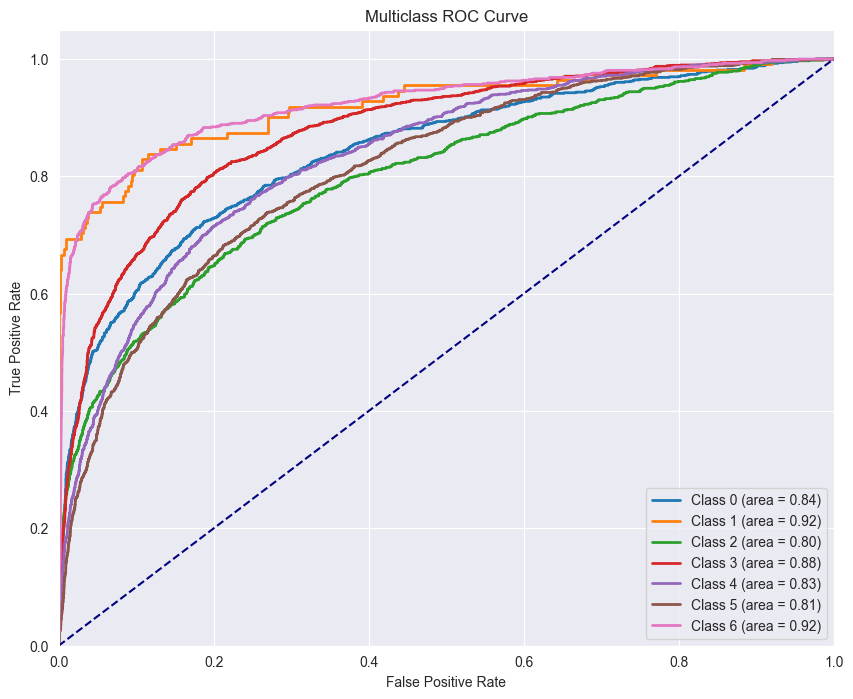

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [18]:
# Assuming y_test_fn is your test labels and svm_clf is your trained classifier
y_prob = clf_fn.predict_proba(X_test_fn)
y_bin = label_binarize(y_test_fn, classes=[0, 1, 2, 3, 4, 5, 6])
n_classes = y_bin.shape[1]

# Compute ROC curve and ROC area for each class
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plotting
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label='Class {} (area = {:.2f})'.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curve')
plt.legend(loc='lower right')
plt.show()

print(label_mapping)

### 3.3 Evaluation metrics

In [35]:
train_accuracy = accuracy_score(y_train_fn, y_train_predicted_fn)
train_precision = precision_score(y_train_fn, y_train_predicted_fn, average='macro')
train_recall = recall_score(y_train_fn, y_train_predicted_fn, average='macro')
train_f1_score = f1_score(y_train_fn, y_train_predicted_fn, average='macro')

print("Training Accuracy:", train_accuracy)
print("Training Precision:", train_precision)
print("Training Recall:", train_recall)
print("Training F1 Score:", train_f1_score)

# Test metrics
test_accuracy = accuracy_score(y_test_fn, y_predicted_fn)
test_precision = precision_score(y_test_fn, y_predicted_fn, average='macro')
test_recall = recall_score(y_test_fn, y_predicted_fn, average='macro')
test_f1_score = f1_score(y_test_fn, y_predicted_fn, average='macro')

print("\nTest Accuracy:", test_accuracy)
print("Test Precision:", test_precision)
print("Test Recall:", test_recall)
print("Test F1 Score:", test_f1_score)

Training Accuracy: 0.9852659444773416
Training Precision: 0.9862432989684814
Training Recall: 0.9843971920548594
Training F1 Score: 0.9853093625075651

Test Accuracy: 0.5792699916411257
Test Precision: 0.6045749597280335
Test Recall: 0.5821882404496537
Test F1 Score: 0.591811913091196


### 3.4 Confusion matrix

<Figure size 1000x800 with 0 Axes>

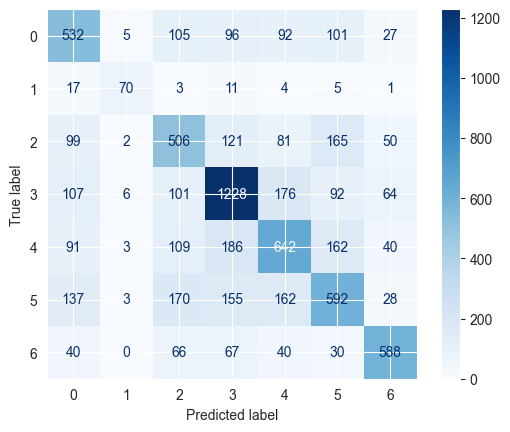

In [30]:
cm_facenet = confusion_matrix(y_test_fn, y_predicted_fn, labels=clf_fn_wo.classes_)
disp = ConfusionMatrixDisplay(cm_facenet, display_labels=clf_fn_wo.classes_)

# Increase figure size for better clarity
plt.figure(figsize=(10, 8))

# Use a larger fontsize to make sure text is readable, but adjust according to your needs
disp.plot(cmap=plt.cm.Blues, xticks_rotation='vertical', values_format='.0f')
plt.show()

### 3.5 Classwise accuracy calculation

In [125]:
def calculate_classwise_accuracy(confusion_matrix):
    """
    Purpose: This function generates classwise accuracy
    :param confusion_matrix: list Confusion matrix
    :return class_accuracies: list List containing class accuracies 
    """
    class_accuracies = []
    for i in range(len(confusion_matrix)):
        true_positives = confusion_matrix[i][i]
        total_actual_class = sum(confusion_matrix[i])
        class_accuracies.append(true_positives / total_actual_class)
    return class_accuracies

# Confusion matrix values as extracted from above
confusion_matrix_values = [
    [532, 5, 105, 96, 92, 101, 27],
    [17, 70, 3, 11, 4, 5, 1],
    [99, 2, 506, 121, 81, 165, 50],
    [107, 6, 101, 1228, 176, 92, 64],
    [91, 3, 109, 186, 642, 162, 40],
    [137, 2, 170, 155, 162, 592, 28],
    [40, 0, 66, 67, 40, 30, 588]
]

# Calculate and print class-wise accuracies
classwise_accuracies = calculate_classwise_accuracy(confusion_matrix_values)
for i, accuracy in enumerate(classwise_accuracies):
    print(f'Class {i} Accuracy: {accuracy:.2%}')

Class 0 Accuracy: 55.53%
Class 1 Accuracy: 63.06%
Class 2 Accuracy: 49.41%
Class 3 Accuracy: 69.22%
Class 4 Accuracy: 52.07%
Class 5 Accuracy: 47.51%
Class 6 Accuracy: 70.76%


### 3.6 Misclassification analysis

#### 3.6.1 Plotting images misclassified

In [39]:
labels_emotion = ['angry', 'disgusted', 'fearful', 'happy', 'neutral', 'sad', 'surprised'] 

fi_test = open("labels_test.txt", "r").read().splitlines()

image_info_list = []

for i in range(len(y_test_fn)):
    if (y_test_fn[i] != y_predicted_fn[i]):
        temp_dict = {}
        temp_dict['actual'] = labels_emotion[y_test_fn[i]]
        temp_dict['predicted'] = labels_emotion[y_predicted_fn[i]]
        temp_dict['path'] = fi_test[i].split(",")[0]
        image_info_list.append(temp_dict)

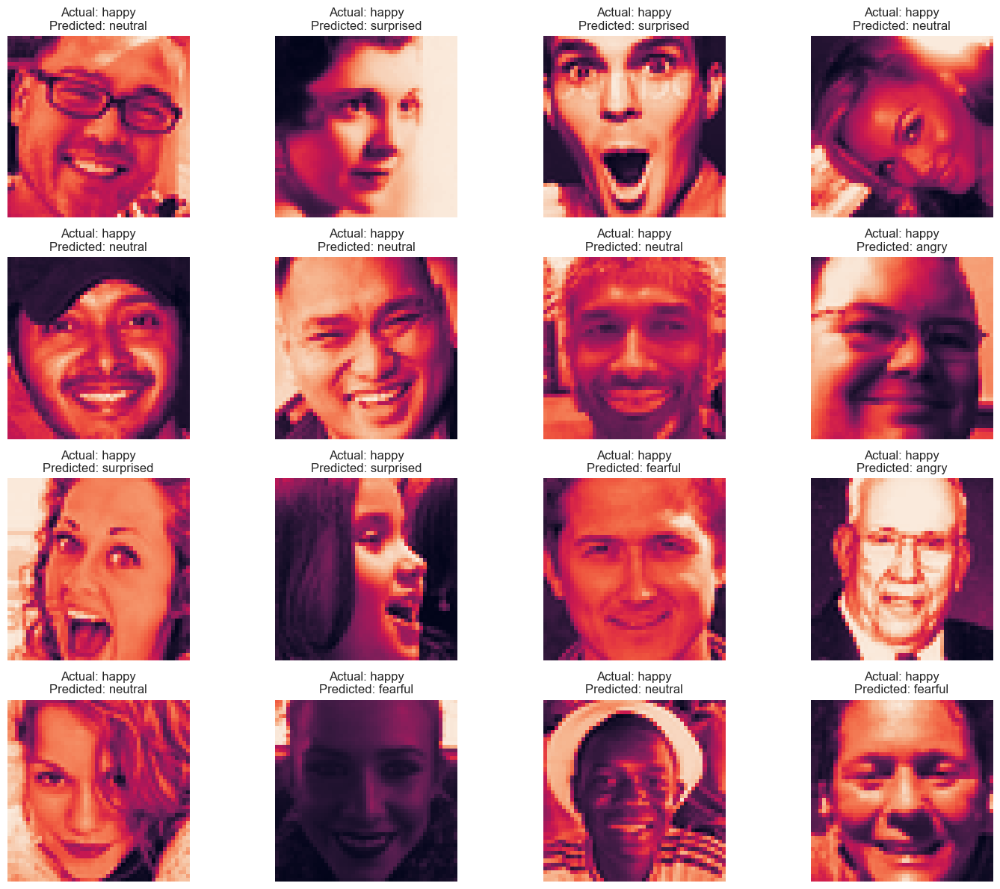

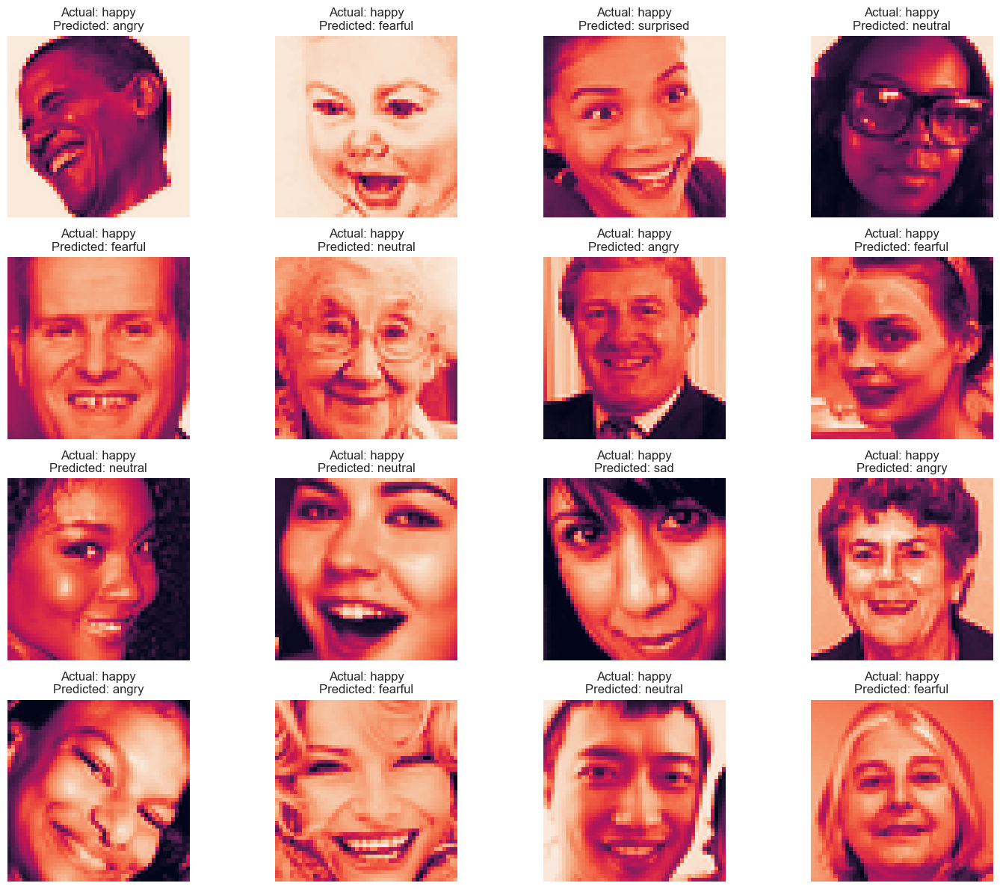

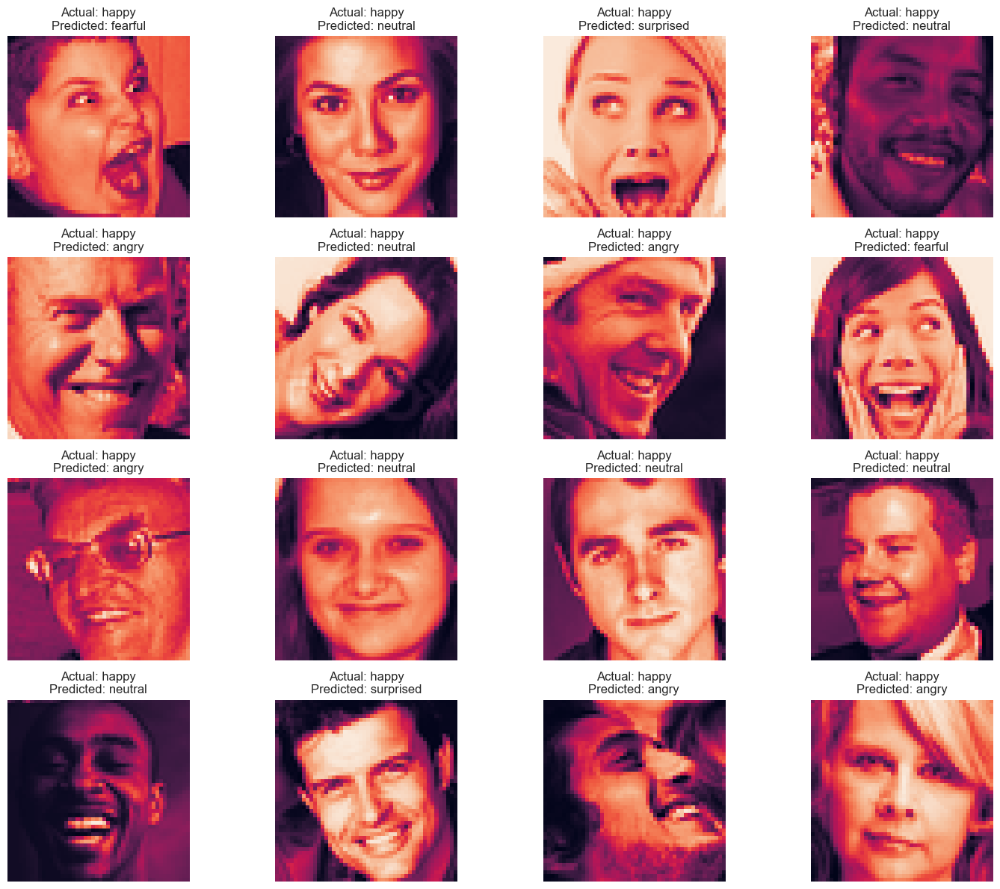

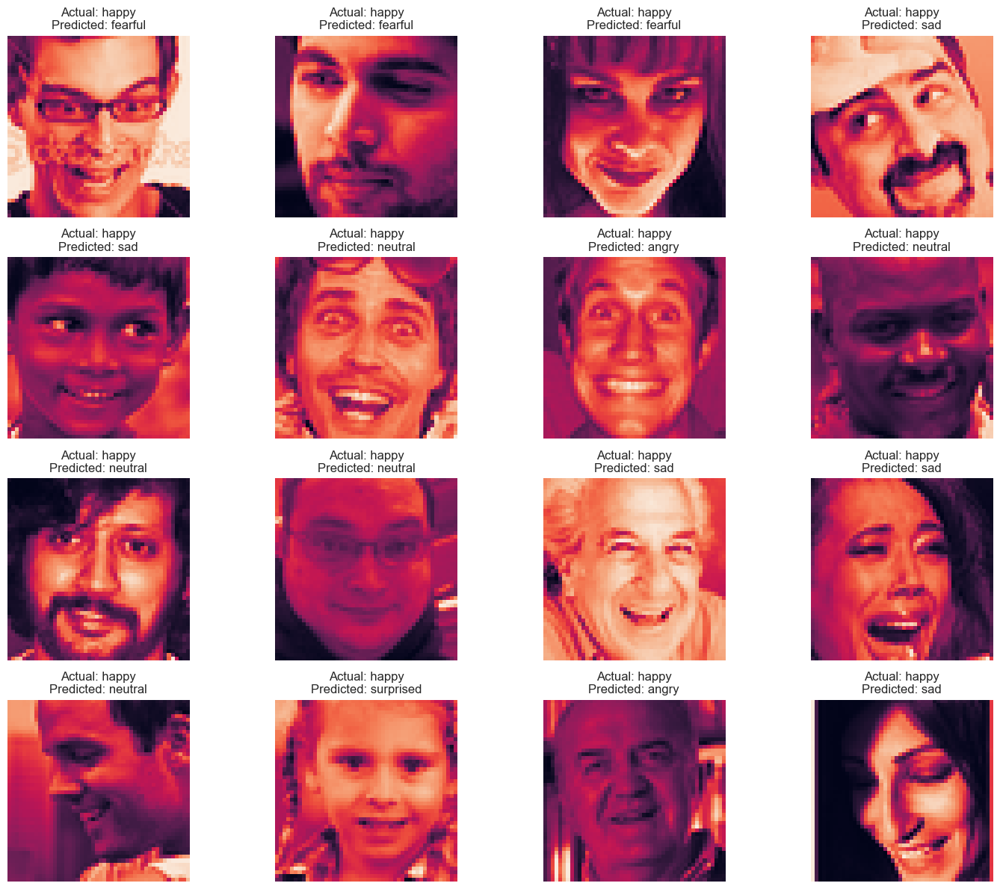

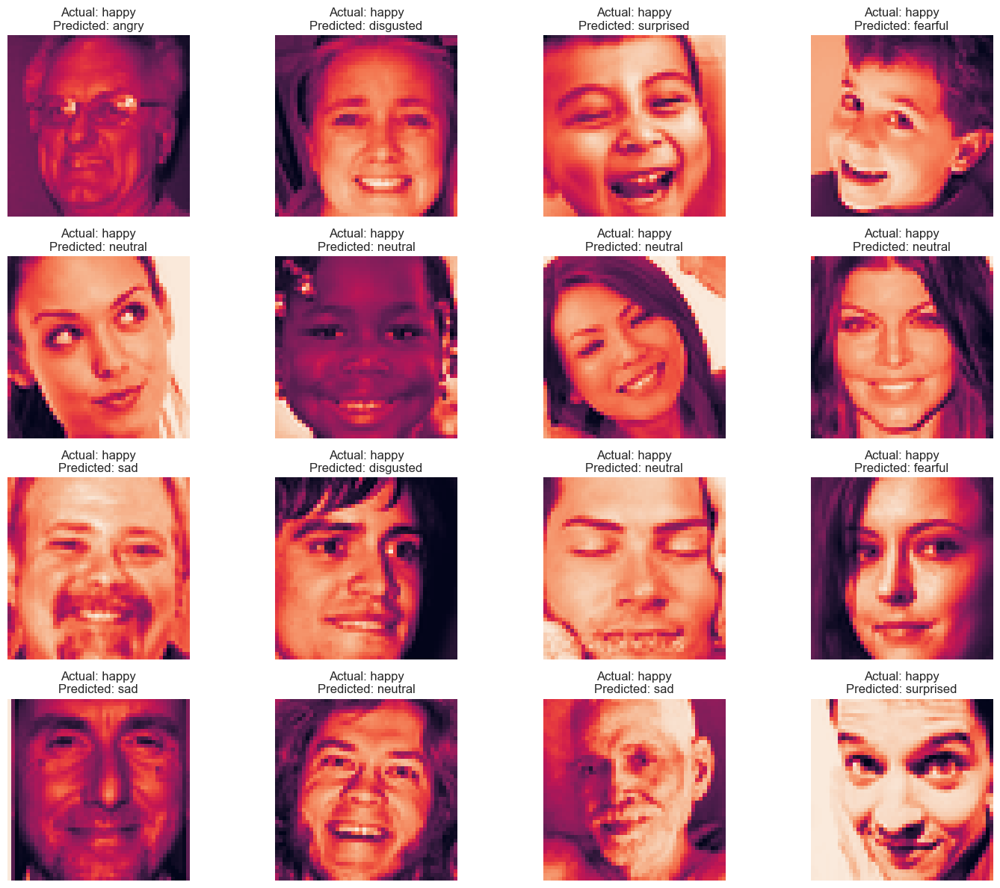

...

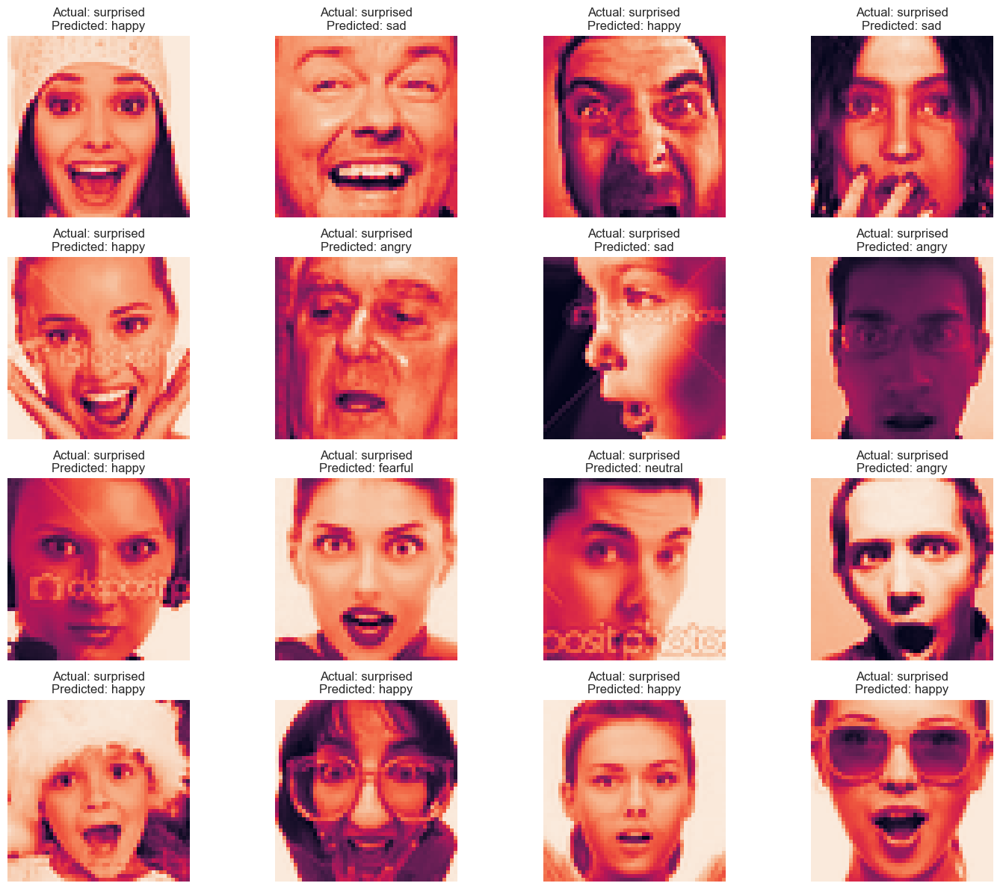

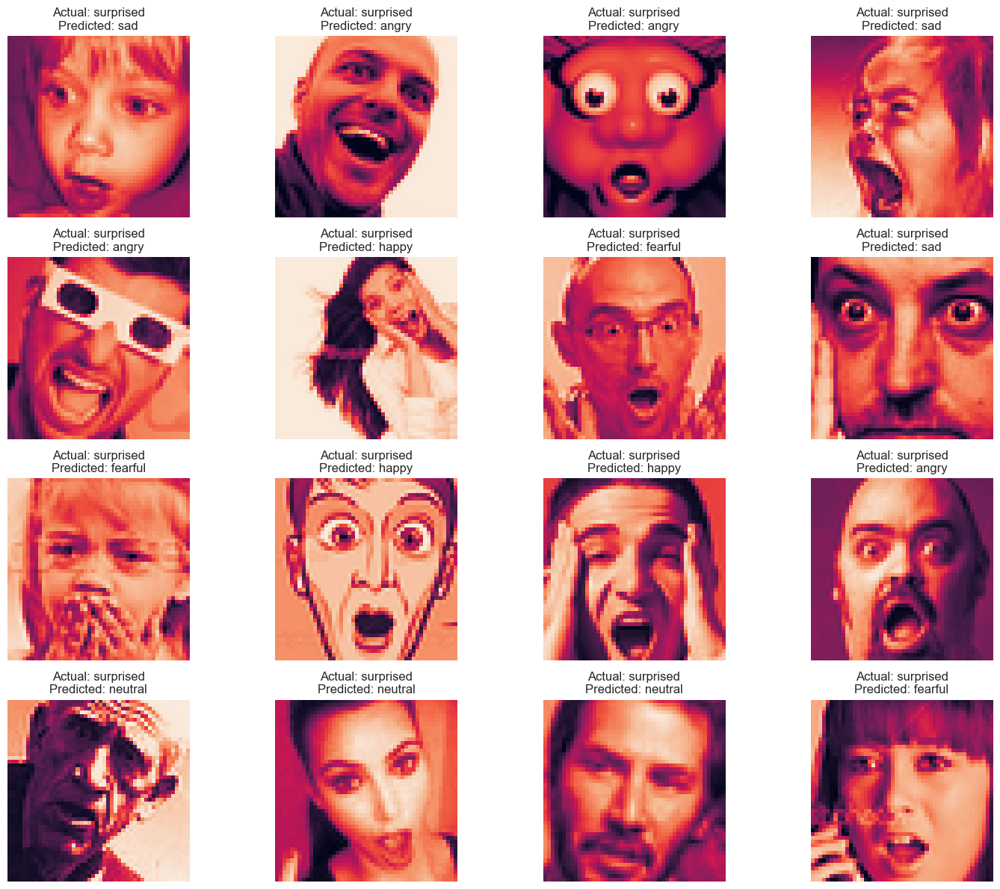

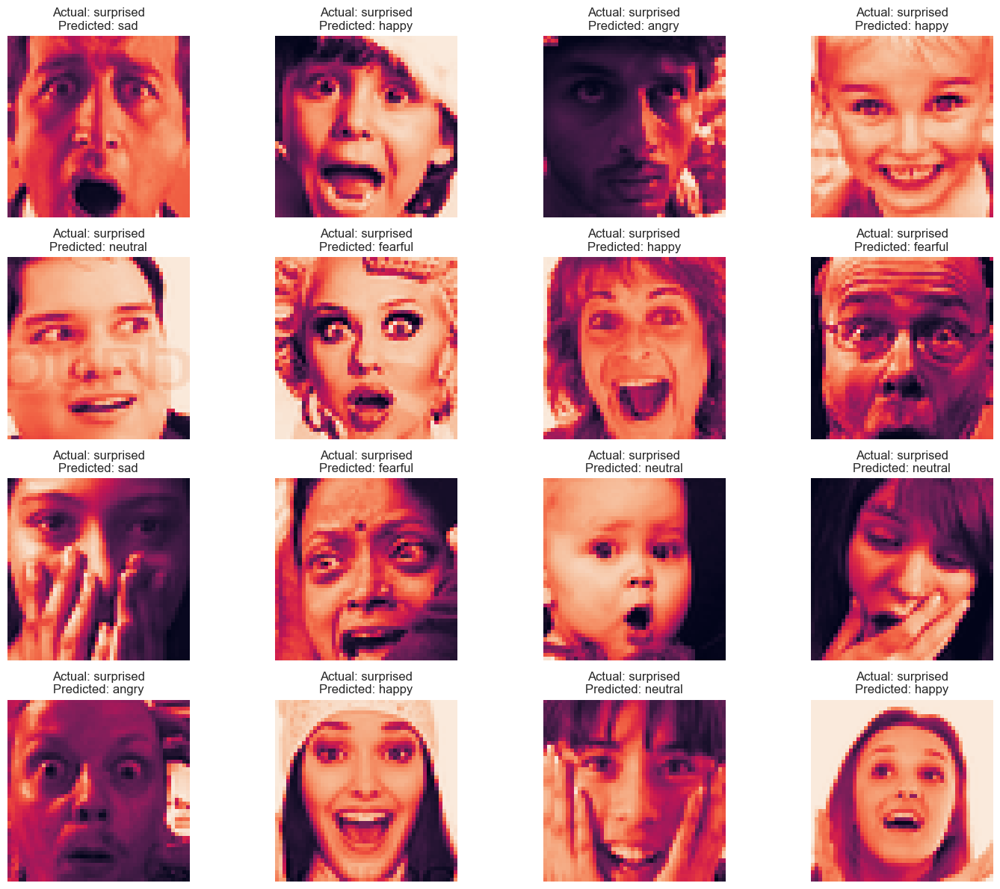

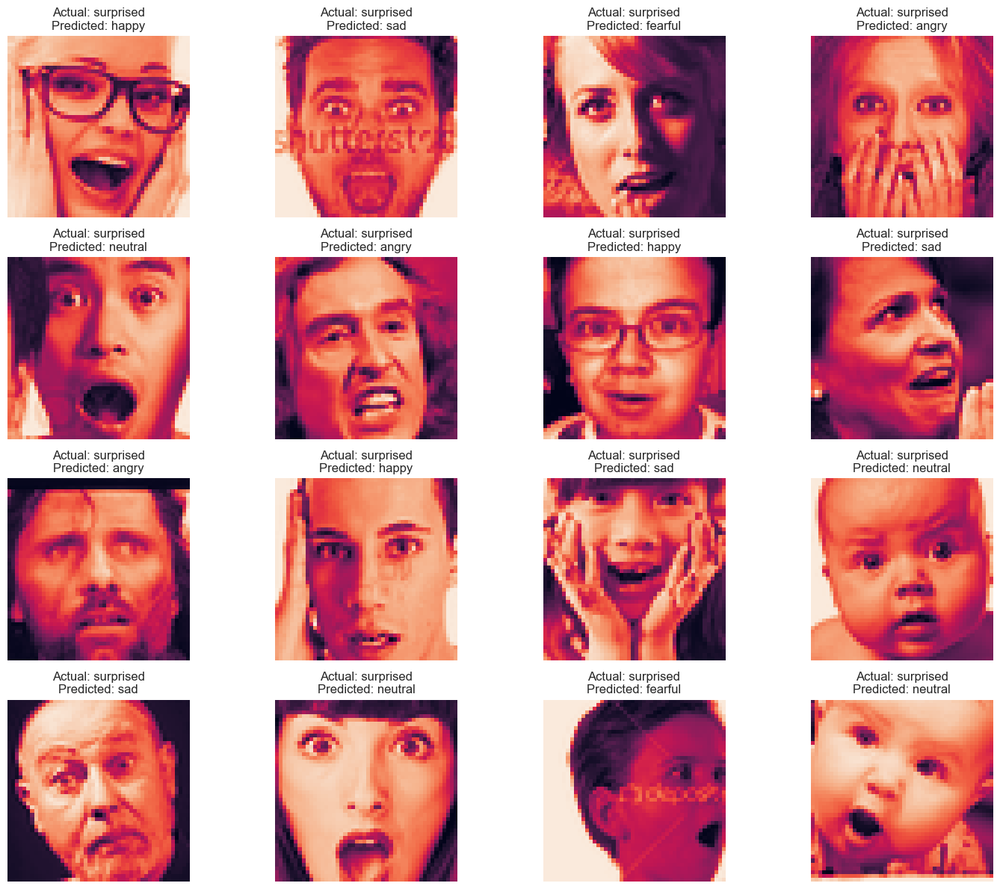

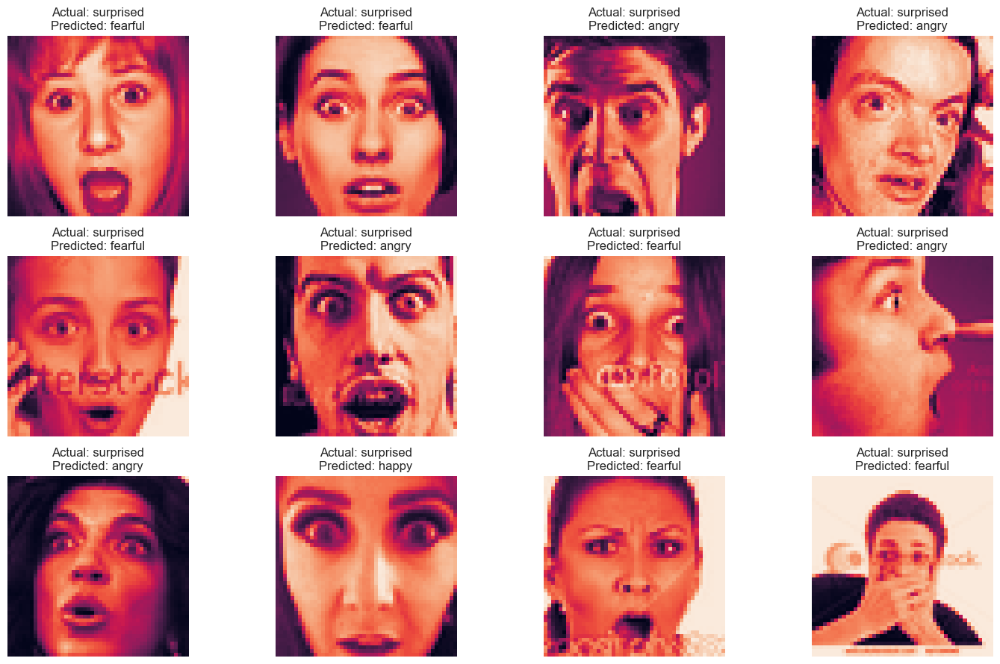

In [40]:
def plot_images_in_batches(image_info_list, batch_size=16):
    """
    Purpose: This function plots wrongly predicted images in batches of 16 
    :param image_info_list: list List of dictionaries containing images with 
    actual and predicted emotions
    """
    # Create batches of images to plot
    for batch_start in range(0, len(image_info_list), batch_size):
        batch_info_list = image_info_list[batch_start:batch_start+batch_size]
        num_images = len(batch_info_list)
        num_rows = num_images // 4 + int(num_images % 4 != 0)
        
        # Create a figure with subplots in a grid
        fig, axs = plt.subplots(num_rows, 4, figsize=(15, num_rows * 3))
        axs = axs.ravel()  # Flatten the array of axes for easy iteration

        for idx, image_info in enumerate(batch_info_list):
            img = mpimg.imread(image_info['path'])
            axs[idx].imshow(img)
            axs[idx].set_title(f"Actual: {image_info['actual']}\nPredicted: {image_info['predicted']}")
            axs[idx].axis('off')  # Hide the axes

        # Hide any remaining empty subplots
        for ax in axs[len(batch_info_list):]:
            ax.axis('off')

        # Adjust layout to prevent overlap and display the plot
        plt.tight_layout()
        plt.show()

# Call the function with your list of image info
plot_images_in_batches(image_info_list)

#### 3.6.2 Interesting misclassifications

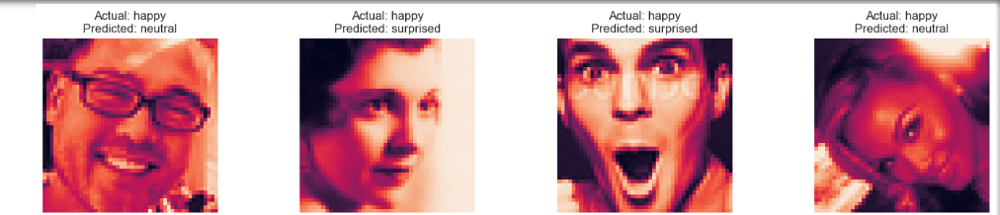

Our analysis indicates that there's a tendency for the classifier to confuse positive emotions amongst themselves, as is also observed with negative ones. This is understandable given the subtle similarities in facial expressions of positive emotions like happiness and surprise, where, for instance, the widening of the eyes can be a common feature. Similarly, the expression of happiness and neutrality can appear remarkably alike in individuals with certain facial structures, making them prone to misclassification.

- <b><u>Image 1:</u></b> Our classifier predicted 'neutral' for an expression that was actually 'happy.' The person's lips appeared relatively flat, lacking the pronounced upward curve typically associated with a smile, which may have led the classifier to a more neutral interpretation.

- <b><u>Image 2:</u></b> The classifier identified an expression as 'surprised' when it was labeled 'happy.' Here, the widened eyes characteristic of surprise might have overshadowed the subtler indicators of a smile, skewing the classification.

- <b><u>Image 3:</u></b> This image labeled 'happy' was classified as 'surprised,' likely due to a misinterpretation of the facial cues by the classifier.

- <b><u>Image 4:</u></b> This image labeled 'happy' was again classified as 'neutral.' The restrained lip movement that lacked the distinctive curvature of a smile could have been the contributing factor.

These observations suggest that certain images in the dataset may be mislabeled or their features may not distinctly contribute to the classifier's learning process, thereby muddling the decision boundaries between classes. It underscores the necessity for a meticulously curated and labeled dataset that supports the development of a classifier capable of delineating clear decision boundaries among various emotional expressions.

### 3.7 Observations

Our fine-tuning of the SVM's hyperparameters, focusing on varying values for C, gamma, and the kernel, led to the determination that the optimal settings were <b><u>C=10, gamma=1, and kernel='rbf'</u></b>. 

Here's a concise interpretation:

- <b><u>C - Regularization Parameter:</u></b> 
The chosen C value of 10 strikes a balance, not too lenient or too strict, indicating a moderate margin width which aims to balance margin size and classification accuracy.

- <b><u>Gamma - Kernel Coefficient: </u></b>
The selected gamma value of 1 suggests a preference for a decision boundary that's relatively sensitive to individual data points, fitting more closely to the training data, which may explain the higher training accuracy and a potential for overfitting.

- <b><u>Kernel: </u></b>
The 'rbf' kernel was found to be most effective, likely due to its ability to handle the non-linearity within our high-dimensional data, applying the kernel trick to separate classes in a transformed space efficiently.

<b>Classwise accuracies:</b>
- Class Angry Accuracy: 55.53%
- Class Disgusted Accuracy: 63.06%
- Class Fearful Accuracy: 49.41%
- Class Happy Accuracy: 69.22%
- Class Neutral Accuracy: 52.07%
- Class Sad Accuracy: 47.51%
- Class Surprised Accuracy: 70.76%

Class-wise accuracies were calculated as follows, indicating a stronger predictive performance for positive emotions such as 'Happy' and 'Surprised', and a lower performance for negative emotions like 'Angry' and 'Disgusted'. This variance in predictive accuracy could correlate with the imbalance in the availability of training images per class, with negative emotions being underrepresented. Misclassifications tend to occur between emotions that are closely related, further emphasizing the complexity of distinguishing between nuanced emotional expressions.

### 3.8 PCA on dataset for Facenet

#### 3.8.1 Data Transformation

In [26]:
# Fitting the scaler on training data and transforming train and test sets
X_train_scaled = scaler.fit_transform(X_train_fn)
X_test_scaled = scaler.transform(X_test_fn)

pca = PCA(n_components=50)
X_train_transform = pca.fit_transform(X_train_scaled)
X_test_transform = pca.fit_transform(X_test_scaled)

#### 3.8.2 SVM fit for transformed data

In [27]:
clf_fn_pca = svm.SVC(C=10, gamma=1, kernel='rbf', probability=True)
clf_fn_pca.fit(X_train_transform, y_train_fn)

SVC(C=10, gamma=1, probability=True)

In [31]:
y_train_predicted_fn_pca = clf_fn_pca.predict(X_train_transform)
y_test_predicted_fn_pca = clf_fn_pca.predict(X_test_transform)

In [41]:
clf_fn_pca_wo = svm.SVC(C=10, gamma=1, kernel='rbf')
clf_fn_pca_wo.fit(X_train_transform, y_train_fn)

SVC(C=10, gamma=1)

In [42]:
y_train_predicted_fn_pca_wo = clf_fn_pca_wo.predict(X_train_transform)
y_test_predicted_fn_pca_wo = clf_fn_pca_wo.predict(X_test_transform)

#### 3.8.3 ROC curve after PCA

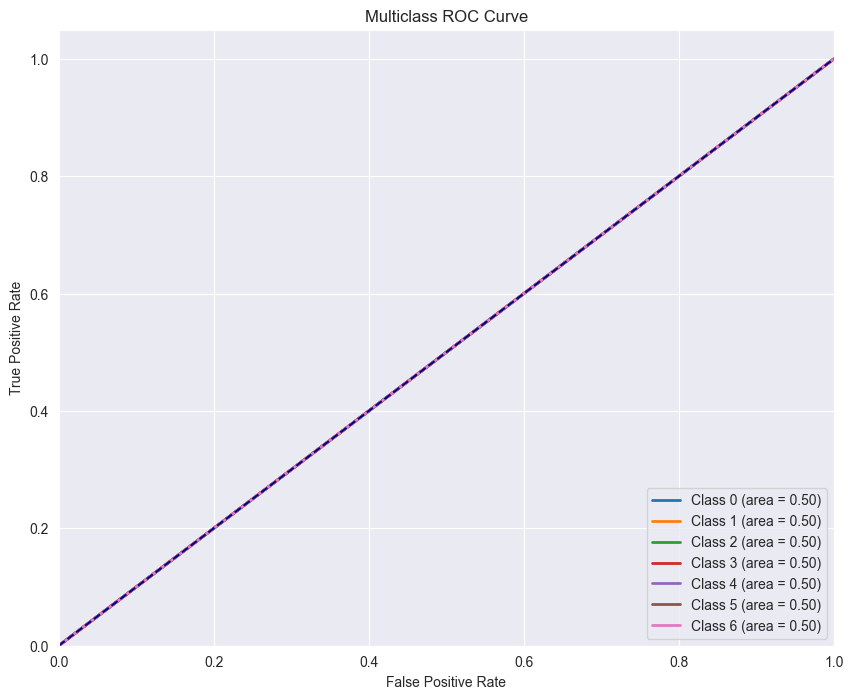

In [47]:
# Assuming y_test_fn is your test labels and svm_clf is your trained classifier
y_prob = clf_fn_pca.predict_proba(X_test_transform)
y_bin = label_binarize(y_test_fn, classes=[0, 1, 2, 3, 4, 5, 6])
n_classes = y_bin.shape[1]

# Compute ROC curve and ROC area for each class
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plotting
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label='Class {} (area = {:.2f})'.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curve')
plt.legend(loc='lower right')
plt.show()


#### 3.8.4 Accuracy after PCA

In [43]:
train_accuracy = accuracy_score(y_train_fn, y_train_predicted_fn_pca_wo)
train_precision = precision_score(y_train_fn, y_train_predicted_fn_pca_wo, average='macro')
train_recall = recall_score(y_train_fn, y_train_predicted_fn_pca_wo, average='macro')
train_f1_score = f1_score(y_train_fn, y_train_predicted_fn_pca_wo, average='macro')

print("Training Accuracy:", train_accuracy)
print("Training Precision:", train_precision)
print("Training Recall:", train_recall)
print("Training F1 Score:", train_f1_score)

# Test metrics
test_accuracy = accuracy_score(y_test_fn, y_test_predicted_fn_pca_wo)
test_precision = precision_score(y_test_fn, y_test_predicted_fn_pca_wo, average='macro')
test_recall = recall_score(y_test_fn, y_test_predicted_fn_pca_wo, average='macro')
test_f1_score = f1_score(y_test_fn, y_test_predicted_fn_pca_wo, average='macro')

print("\nTest Accuracy:", test_accuracy)
print("Test Precision:", test_precision)
print("Test Recall:", test_recall)
print("Test F1 Score:", test_f1_score)

Training Accuracy: 0.9985022118499425
Training Precision: 0.9982318540617815
Training Recall: 0.9981872162048663
Training F1 Score: 0.9982092463049431

Test Accuracy: 0.24714405126776262
Test Precision: 0.0353062930382518
Test Recall: 0.14285714285714285
Test F1 Score: 0.05661943061406869


#### 3.8.5 Confusion matrix after PCA

<Figure size 1000x800 with 0 Axes>

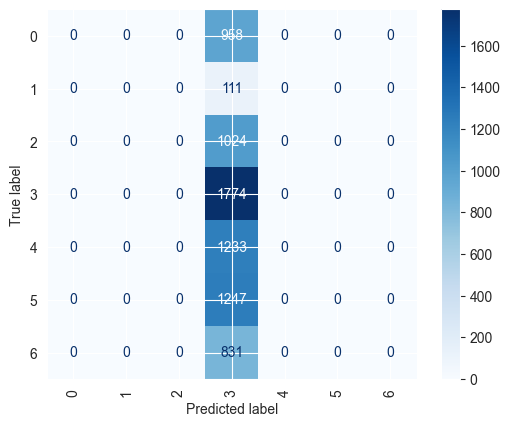

In [46]:
cm_facenet_pca_wo = confusion_matrix(y_test_fn, y_test_predicted_fn_pca_wo, labels=clf_fn_pca_wo.classes_)
disp_pca_wo = ConfusionMatrixDisplay(cm_facenet_pca_wo, display_labels=clf_fn_pca_wo.classes_)

# Increase figure size for better clarity
plt.figure(figsize=(10, 8))

# Use a larger fontsize to make sure text is readable, but adjust according to your needs
disp_pca_wo.plot(cmap=plt.cm.Blues, xticks_rotation='vertical', values_format='.0f')
plt.show()

#### 3.8.6 Observations

The ROC curve, where each class has an area under the curve (AUC) of 0.50, indicates that the classifier's performance is equivalent to random guessing for each class. The true positive rate (sensitivity) increases linearly with the false positive rate (1-specificity) for all classes, which is what you would expect from a model that has no discriminative power between the classes and is randomly making predictions.

In practice, an AUC of 0.50 suggests that the model has no ability to distinguish between the positive class and the negative class. For a useful classifier, you typically want the AUC to be as high as possible, where 1.0 represents a perfect classifier. Values below 0.5 suggest that a model is performing worse than random chance, which sometimes indicates that the classes are being inversely predicted.

This situation could be due to several factors, such as:

- The model may not have learned anything meaningful from the data.
- The features may not be informative or discriminative enough to separate the classes.
- The dataset might be highly imbalanced or too complex for the model.

<b>Classwise accuracies:</b>
- Class Angry Accuracy: 0%
- Class Disgusted Accuracy: 0%
- Class Fearful Accuracy: 0%
- Class Happy Accuracy: 100%
- Class Neutral Accuracy: 0%
- Class Sad Accuracy: 0%
- Class Surprised Accuracy: 0%

Thus, even though the PCA scree plot seemed to tell that 50 components were more than enough. In practice, that was not the case as these are facial features and every feature plays an important role contirbuting in the formation of the emotion on the face. 

## 4. Face reps using VGG-Face

VGGFace embeddings are generated by a convolutional neural network (CNN) architecture that is used for face recognition tasks. This model, developed by the Visual Graphics Group (VGG) at Oxford University, was initially introduced for image recognition tasks and later adapted for face recognition.

<b><u>VGGFace Embeddings:</u></b>
1. Feature Vectors: The embeddings are high-dimensional feature vectors extracted from one of the fully connected layers of the network. These vectors effectively summarize the most salient features of the input face images.
2. Face Similarity: Just like with other deep learning face embeddings, the idea is that the Euclidean distance (or sometimes cosine similarity) between two face embeddings can be used to determine how similar two faces are. Small distances imply similar or same identities, while larger distances imply different identities.
3. Dimensionality: The dimensionality of the embeddings depends on the layer from which they are extracted. For example, if extracted from the first fully connected layer of VGG-16, the embeddings would be 4096-dimensional vectors.
4. Applications: These embeddings can be used for various applications, including face verification, identification, and clustering, across different domains like security and social media.

The power of VGGFace embeddings lies in their ability to capture and encode complex facial features into a form that can be easily used for classification, clustering, or similarity comparison tasks. They have been used as benchmarks and foundational models in many facial recognition research efforts and applications.

### 4.1 Feature reps creation

In [ ]:
models = ["VGG-Face", "Facenet", "OpenFace", "Dlib", "ArcFace"]

In [ ]:
def create_deepface_reps(labels_file, csv_file):
    """
    Purpose: This function creates feature reps for VGG 
    :param labels_file: str File with path and labels for images
    :param csv_file: str File to which the embeddings will be written
    """
    for line in labels_file:
        split_arr = line.split(",")
        img_path = split_arr[0]
        label = split_arr[1]
        try:
            embeddings = DeepFace.represent(img_path, model_name = models[0])#, enforce_detection=False)
            csv_file.write("{} , {}\n".format(embeddings[0]['embedding'], label))
        except Exception as e:
            continue
    csv_file.close()  

In [ ]:
train_vgg = "train_vgg.csv"
test_vgg = "test_vgg.csv"

In [ ]:
if generate_reps:
    csv_file_train_df = open(train_vgg, "w")
    csv_file_test_df = open(test_vgg, "w")

In [ ]:
if generate_reps:
    create_deepface_reps(labels_file_train, csv_file_train_df)
    create_deepface_reps(labels_file_test, csv_file_test_df)

In [48]:
final_train = "train_vgg_final.csv"
final_test = "test_vgg_final.csv"

In [ ]:
def helper(fi, fi1):
    """
    Purpose: This function is a helper function to create features file as required 
    :param fi: str File Input file
    :param fi1: str File Output file
    """
    for i in range(len(fi)):
        x = fi[i].split(']')
        line =  (x[0]+ x[1]).split('[')[1]
        fi1.write(line+"\n")
    fi1.close()

In [ ]:
file_train_df = open(train_vgg, "r").read().splitlines()
file_train_df_final = open(final_train, "w")
file_test_df = open(test_vgg, "r").read().splitlines()
file_test_df_final = open(final_test, "w")

In [ ]:
helper(file_train_df, file_train_df_final)
helper(file_test_df, file_test_df_final)

### 4.2 Data transformation (PCA)

In [49]:
df_train = pd.read_csv(final_train, header=None)
df_train.head()

0         1         2     3     4         5         6     7         8      
0   0.0  0.019521  0.000000   0.0   0.0  0.000000  0.000000   0.0  0.003121  \
1   0.0  0.000000  0.100856   0.0   0.0  0.008221  0.049338   0.0  0.000000   
2   0.0  0.000000  0.033693   0.0   0.0  0.013898  0.119639   0.0  0.000000   
3   0.0  0.062594  0.054887   0.0   0.0  0.000000  0.000000   0.0  0.000000   
4   0.0  0.000000  0.000000   0.0   0.0  0.000000  0.000000   0.0  0.000000   

   9         10    11    12        13    14        15    16    17    18     
0   0.0  0.000000   0.0   0.0  0.042338   0.0  0.000000   0.0   0.0   0.0  \
1   0.0  0.000000   0.0   0.0  0.000000   0.0  0.069933   0.0   0.0   0.0   
2   0.0  0.000209   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   
3   0.0  0.000000   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   
4   0.0  0.000000   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   

   19        20    21        22        23    24    25       26        27     
0   0.0  0.025904   0.0  0.000000  0.000000   0.0   0.0  0.00467  0.005305  \
1   0.0  0.089679   0.0  0.016665  0.000000   0.0   0.0  0.00000  0.000000   
2   0.0  0.000000   0.0  0.000000  0.000000   0.0   0.0  0.00000  0.000000   
3   0.0  0.097944   0.0  0.000000  0.015418   0.0   0.0  0.00000  0.000000   
4   0.0  0.000000   0.0  0.000000  0.060908   0.0   0.0  0.00000  0.000000   

       28    29    30    31    32    33    34        35    36    37    38     
0  0.000000   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0   0.0  \
1  0.000000   0.0   0.0   0.0   0.0   0.0   0.0  0.090579   0.0   0.0   0.0   
2  0.011186   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0   0.0   
3  0.070052   0.0   0.0   0.0   0.0   0.0   0.0  0.032654   0.0   0.0   0.0   
4  0.054709   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0   0.0   

       39        40        41    42        43    44        45        46     
0  0.036146  0.000000  0.004168   0.0  0.000000   0.0  0.000000  0.026331  \
1  0.000000  0.000000  0.000000   0.0  0.000000   0.0  0.000000  0.074696   
2  0.000000  0.005684  0.000000   0.0  0.000000   0.0  0.045117  0.000000   
3  0.034654  0.000000  0.000000   0.0  0.000000   0.0  0.000000  0.001398   
4  0.039468  0.000000  0.000000   0.0  0.005496   0.0  0.000000  0.000000   

   47    48    49    50    51    52        53    54    55        56    57     
0   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0  0.000000   0.0  \
1   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0  0.011666   0.0   
2   0.0   0.0   0.0   0.0   0.0   0.0  0.046498   0.0   0.0  0.000000   0.0   
3   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0  0.000000   0.0   
4   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0   0.0  0.000000   0.0   

   58    59    60    61    62    63    64    65    66    67        68     
0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0  0.000000  \
1   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0  0.055894   
2   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   
3   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   
4   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0  0.000000   

       69    70    71        72        73    74        75    76    77    78     
0  0.000000   0.0   0.0  0.045525  0.025639   0.0  0.000000   0.0   0.0   0.0  \
1  0.000000   0.0   0.0  0.000000  0.000000   0.0  0.050753   0.0   0.0   0.0   
2  0.000000   0.0   0.0  0.001011  0.000000   0.0  0.001540   0.0   0.0   0.0   
3  0.018714   0.0   0.0  0.043384  0.008305   0.0  0.000000   0.0   0.0   0.0   
4  0.000000   0.0   0.0  0.060521  0.000000   0.0  0.000000   0.0   0.0   0.0   

   79        80    81    82    83    84        85        86    87        88     
0   0.0  0.000000   0.0   0.0   0.0   0.0  0.000000  0.000000   0.0  0.000000  \
1   0.0  0.000000   0.0   0.0   0.0   0.0  0.000000  0.009961   0.0  0.000000   
2 

In [50]:
le = LabelEncoder()
X_train_vgg = df_train.iloc[:, :-1].to_numpy()  # Features
y_train_vgg = le.fit_transform(df_train.iloc[:, -1]) # Target

label_mapping = dict(zip(le.classes_, range(len(le.classes_))))
print(label_mapping)

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [51]:
scaler = StandardScaler()

# Fitting the scaler on training data and transforming train and test sets
X_train_scaled_vgg = scaler.fit_transform(X_train_vgg)

pca_vgg = PCA()
pca_vgg.fit_transform(X_train_scaled_vgg)

array([[-1.53748526e+01, -6.74447512e+00, -8.59438027e+00, ...,
         2.30208153e-18,  6.45846543e-19,  5.15531597e-19],
       [ 1.28708637e+01, -8.37397576e+00, -4.05727031e-01, ...,
         2.30208153e-18,  6.45846543e-19,  5.15531597e-19],
       [-1.40063672e+00,  3.24803384e-02,  1.13483336e+01, ...,
         2.30208153e-18,  6.45846543e-19,  5.15531597e-19],
       ...,
       [-6.82606944e+00, -7.77463575e+00, -1.34806626e+01, ...,
        -3.61137040e-16, -2.26289051e-16,  1.09380759e-16],
       [ 4.89400846e+00, -6.25697264e+00,  2.19314858e+00, ...,
         2.30208153e-18,  6.45846543e-19,  5.15531597e-19],
       [ 1.52592448e+00, -8.16788667e-01,  7.59253243e+00, ...,
         2.30208153e-18,  6.45846543e-19,  5.15531597e-19]])

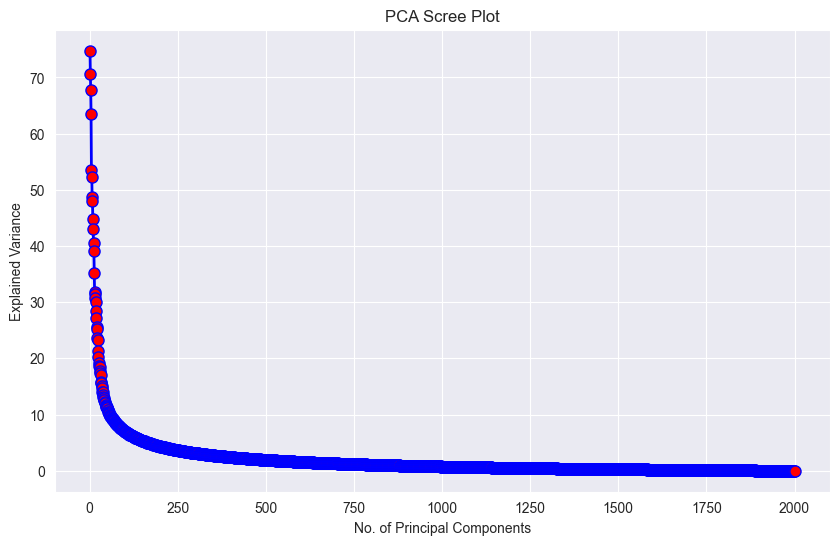

In [52]:
explained_variance_vgg = pca_vgg.explained_variance_
variance_ratios_vgg = pca_vgg.explained_variance_ratio_

# Generating a scree plot to visualize the significance of each principal component
plt.figure(figsize=(10, 6))
plt.plot(np.arange(1, 1 + len(explained_variance_vgg)), explained_variance_vgg, 
         marker='o', linestyle='-', color='b', markerfacecolor='red', markersize=8, linewidth=2)
plt.title('PCA Scree Plot')
plt.xlabel('No. of Principal Components')
plt.ylabel('Explained Variance')
plt.grid(True)
plt.show()

### 4.3 <b>Observations:</b>
1. Initial Variance Drop: The first few components account for a significantly higher proportion of the variance compared to the rest. After approximately the 10th principal component, the amount of variance explained by each subsequent component decreases drastically.

2. Diminishing Returns: After the steep drop, the curve flattens out considerably. The incremental variance explained by additional components is minimal after the first few components.

3. Dimensionality Reduction Opportunity: The plot suggests that one could reduce the dimensionality of the dataset to a small number of principal components without losing much of the total variance. This is beneficial for reducing the complexity of models and avoiding overfitting.

4. Elbow Method: Typically, one looks for an "elbow" in the Scree plot where the explained variance starts to level off to determine the optimal number of components to keep. However, in this plot, the elbow is not very distinct. One might argue it occurs around the 10th component, but the decision might require further investigation or additional criteria, such as a cumulative variance threshold.

## 5. SVM Training using VGG Reps

### 5.1 Hyperparameter tuning

This section contains the code for hyperparameter tuning. As the hyperparameter tuning with cross validation takes a long time to run, we have used separate notebooks to run this code. This code is present only for reference and not actually run. 

The final best parameters that we found for SVM with FaceNet reps are:
<b><u>C = 10,
gamma = 1,
kernel = 'rbf' </u></b>

In [ ]:
# Define the model
clf_vgg = svm.SVC()

# Define the parameter grid
param_grid = {
    'C': [0.1, 1, 10, 100, 1000],
    'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
    'kernel': ['linear', 'poly', 'rbf']
}

# Set up GridSearchCV
grid_search_vgg = GridSearchCV(estimator=clf_vgg, param_grid=param_grid, cv=5, verbose=2, scoring='accuracy')

# Fit GridSearchCV
grid_search_vgg.fit(X_train_vgg, y_train_vgg)

# Print the best parameters and the best score
print("Best parameters:", grid_search_vgg.best_params_)
print("Best cross-validation score: {:.2f}".format(grid_search_vgg.best_score_))

### 5.2 Training using SVM

In [53]:
clf_vgg = svm.SVC(C=10, gamma=1, kernel='rbf', probability=True)
clf_vgg.fit(X_train_vgg, y_train_vgg)

SVC(C=10, gamma=1, probability=True)

In [54]:
clf_vgg_wo = svm.SVC(C=10, gamma=1, kernel='rbf')
clf_vgg_wo.fit(X_train_vgg, y_train_vgg)

SVC(C=10, gamma=1)

In [55]:
y_train_predicted_vgg = clf_vgg_wo.predict(X_train_vgg)

In [57]:
df_test = pd.read_csv(final_test, header=None)
df_test.head()

0         1     2     3         4     5     6         7         8      
0  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0  0.000000  0.000000  \
1  0.006106  0.089214   0.0   0.0  0.032623   0.0   0.0  0.000000  0.105565   
2  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0  0.000000  0.000000   
3  0.000000  0.000000   0.0   0.0  0.000000   0.0   0.0  0.000000  0.014152   
4  0.000000  0.024723   0.0   0.0  0.000000   0.0   0.0  0.044559  0.000000   

   9        10    11        12        13    14    15    16    17    18     
0   0.0  0.00000   0.0  0.000000  0.054284   0.0   0.0   0.0   0.0   0.0  \
1   0.0  0.00034   0.0  0.000000  0.000000   0.0   0.0   0.0   0.0   0.0   
2   0.0  0.00000   0.0  0.000000  0.000000   0.0   0.0   0.0   0.0   0.0   
3   0.0  0.00000   0.0  0.000000  0.000000   0.0   0.0   0.0   0.0   0.0   
4   0.0  0.00000   0.0  0.024474  0.000000   0.0   0.0   0.0   0.0   0.0   

       19        20    21    22        23    24       25    26       27     
0  0.000000  0.000000   0.0   0.0  0.000000   0.0  0.00000   0.0  0.00000  \
1  0.000000  0.013844   0.0   0.0  0.000000   0.0  0.01874   0.0  0.07211   
2  0.000000  0.000000   0.0   0.0  0.057667   0.0  0.00000   0.0  0.00000   
3  0.022812  0.058457   0.0   0.0  0.000000   0.0  0.00000   0.0  0.00000   
4  0.004333  0.000000   0.0   0.0  0.000000   0.0  0.00000   0.0  0.00000   

       28    29       30    31        32    33    34    35        36    37     
0  0.012123   0.0  0.00000   0.0  0.000000   0.0   0.0   0.0  0.081877   0.0  \
1  0.000000   0.0  0.00000   0.0  0.000000   0.0   0.0   0.0  0.000000   0.0   
2  0.000000   0.0  0.00000   0.0  0.000000   0.0   0.0   0.0  0.000000   0.0   
3  0.000333   0.0  0.03348   0.0  0.000000   0.0   0.0   0.0  0.000000   0.0   
4  0.000000   0.0  0.00000   0.0  0.063052   0.0   0.0   0.0  0.000000   0.0   

   38        39        40        41    42    43        44    45        46     
0   0.0  0.007909  0.000000  0.039648   0.0   0.0  0.000000   0.0  0.000000  \
1   0.0  0.000000  0.000000  0.000000   0.0   0.0  0.028857   0.0  0.012583   
2   0.0  0.000000  0.049391  0.000000   0.0   0.0  0.000000   0.0  0.000000   
3   0.0  0.000000  0.000000  0.000000   0.0   0.0  0.017908   0.0  0.000000   
4   0.0  0.000000  0.000000  0.000000   0.0   0.0  0.000000   0.0  0.000000   

       47    48        49        50        51    52    53    54        55     
0  0.000000   0.0  0.000000  0.000000  0.034310   0.0   0.0   0.0  0.000000  \
1  0.000000   0.0  0.000000  0.000000  0.015412   0.0   0.0   0.0  0.044763   
2  0.052404   0.0  0.016354  0.000000  0.000000   0.0   0.0   0.0  0.000000   
3  0.000000   0.0  0.000000  0.000000  0.004917   0.0   0.0   0.0  0.000000   
4  0.000000   0.0  0.000000  0.011155  0.000000   0.0   0.0   0.0  0.000000   

   56        57    58       59        60        61    62    63    64    65     
0   0.0  0.000000   0.0  0.00000  0.000000  0.000000   0.0   0.0   0.0   0.0  \
1   0.0  0.007043   0.0  0.00000  0.000000  0.008219   0.0   0.0   0.0   0.0   
2   0.0  0.000000   0.0  0.00000  0.000000  0.000000   0.0   0.0   0.0   0.0   
3   0.0  0.000000   0.0  0.01275  0.009454  0.000000   0.0   0.0   0.0   0.0   
4   0.0  0.000000   0.0  0.02958  0.000000  0.000000   0.0   0.0   0.0   0.0   

   66    67    68    69    70        71    72        73    74    75    76     
0   0.0   0.0   0.0   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0  \
1   0.0   0.0   0.0   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   
2   0.0   0.0   0.0   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   
3   0.0   0.0   0.0   0.0   0.0  0.031202   0.0  0.014029   0.0   0.0   0.0   
4   0.0   0.0   0.0   0.0   0.0  0.000000   0.0  0.000000   0.0   0.0   0.0   

      77        78    79    80    81        82        83        84     
0  0.00000  0.000000   0.0   0.0   0.0  0.000000  0.000000  0.000000  \
1  0.00000  0.000000   0.0   0.0   0.0  0.052673  0.000000  0.000000   
2  0.0000

In [60]:
X_test_vgg = df_test.iloc[:, :-1].to_numpy()  # Features
y_test_vgg = le.fit_transform(df_test.iloc[:, -1]) # Target

label_mapping = dict(zip(le.classes_, range(len(le.classes_))))
print(label_mapping)

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [61]:
y_test_predicted_vgg = clf_vgg_wo.predict(X_test_vgg)

### 5.3 RoC curve

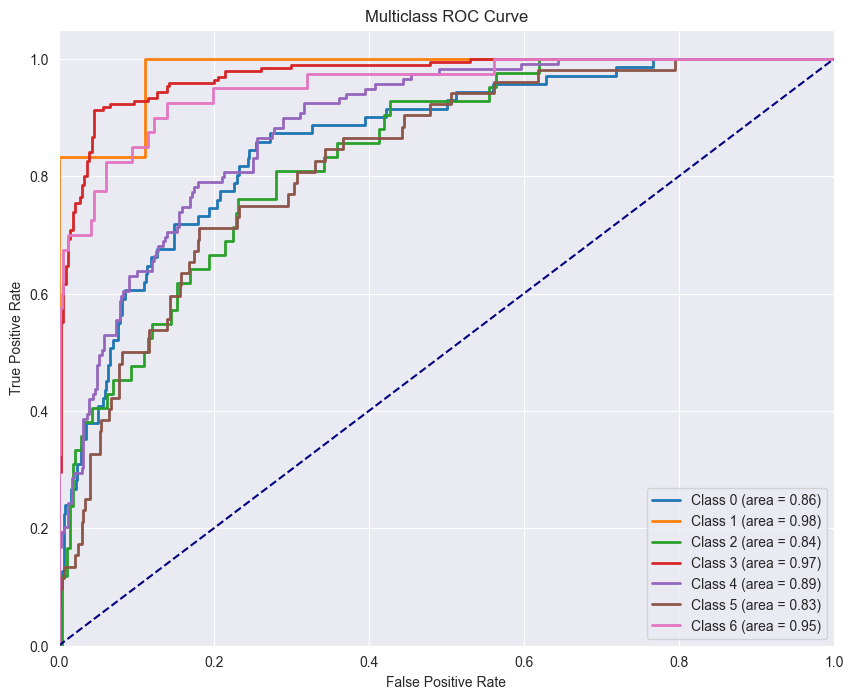

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [66]:
# Assuming y_test_fn is your test labels and svm_clf is your trained classifier
y_prob = clf_vgg.predict_proba(X_test_vgg)
y_bin = label_binarize(y_test_vgg, classes=[0, 1, 2, 3, 4, 5, 6])
n_classes = y_bin.shape[1]

# Compute ROC curve and ROC area for each class
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plotting
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label='Class {} (area = {:.2f})'.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curve')
plt.legend(loc='lower right')
plt.show()

print(label_mapping)

### 5.4 Evaluation metrics

In [74]:
train_accuracy = accuracy_score(y_train_vgg, y_train_predicted_vgg)
train_precision = precision_score(y_train_vgg, y_train_predicted_vgg, average='macro')
train_recall = recall_score(y_train_vgg, y_train_predicted_vgg, average='macro')
train_f1_score = f1_score(y_train_vgg, y_train_predicted_vgg, average='macro')

print("Training Accuracy:", train_accuracy)
print("Training Precision:", train_precision)
print("Training Recall:", train_recall)
print("Training F1 Score:", train_f1_score)

# Test metrics
test_accuracy = accuracy_score(y_test_vgg, y_test_predicted_vgg)
test_precision = precision_score(y_test_vgg, y_test_predicted_vgg, average='macro')
test_recall = recall_score(y_test_vgg, y_test_predicted_vgg, average='macro')
test_f1_score = f1_score(y_test_vgg, y_test_predicted_vgg, average='macro')

print("\nTest Accuracy:", test_accuracy)
print("Test Precision:", test_precision)
print("Test Recall:", test_recall)
print("Test F1 Score:", test_f1_score)

Training Accuracy: 0.9965
Training Precision: 0.9951521933938269
Training Recall: 0.9936653111558054
Training F1 Score: 0.994334875480769

Test Accuracy: 0.6844106463878327
Test Precision: 0.6804100777502312
Test Recall: 0.6032354994311608
Test F1 Score: 0.6283099970894302


### 5.5 Confusion matrix

<Figure size 1000x800 with 0 Axes>

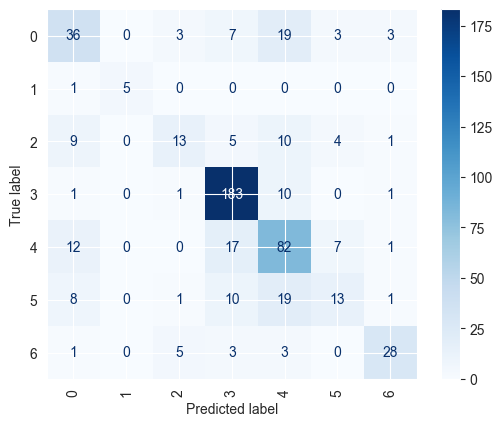

In [73]:
cm_vgg = confusion_matrix(y_test_vgg, y_test_predicted_vgg, labels=clf_vgg_wo.classes_)
disp_vgg = ConfusionMatrixDisplay(cm_vgg, display_labels=clf_vgg_wo.classes_)

# Increase figure size for better clarity
plt.figure(figsize=(10, 8))

# Use a larger fontsize to make sure text is readable, but adjust according to your needs
disp_vgg.plot(cmap=plt.cm.Blues, xticks_rotation='vertical', values_format='.0f')
plt.show()

### 5.6 Observations

Our analysis reveals that the optimal parameters identified for the VGG representations coincide with those determined for the FaceNet representations. However, the VGG model achieves an accuracy that is nearly 10% higher than its FaceNet counterpart, suggesting a superior feature representation. This enhancement in performance may stem from the inherent differences in how each model processes facial features. FaceNet's reliance on the triplet loss function, which emphasizes aligning similar faces, could result in highly similar feature vectors for the same individual exhibiting different expressions. Consequently, an SVM model trained on such data might struggle to delineate the decision boundary effectively, leading to a more complex model with reduced separation capabilities. This aligns with our theoretical understanding of the two architectures: while FaceNet excels in distinguishing identical individuals, VGG's approach may afford a broader discrimination of facial characteristics, beneficial for varied expressions.

<b>Classwise accuracies:</b>
- Class Angry Accuracy: 92.30%
- Class Disgusted Accuracy: 83.33%
- Class Fearful Accuracy: 30.95%
- Class Happy Accuracy: 97%
- Class Neutral Accuracy: 68%
- Class Sad Accuracy: 36.53%
- Class Surprised Accuracy: 70%

An examination of the confusion matrix indicates a pronounced disparity in the number of images across classes, with certain emotions being underrepresented. This disparity has a tangible impact on the resulting feature vectors' balance. In direct comparison with FaceNet, the VGG model struggled with the detection of faces across multiple images, contributing to a skewed dataset that further exacerbated the imbalance during both the training and testing phases. This imbalance likely affected the model's learning process, resulting in the observed variances in class-specific performance.

## 6. MLP classifier

A Multilayer Perceptron (MLP) is a class of feedforward artificial neural network (ANN). An MLP consists of at least three layers of nodes: an input layer, a hidden layer, and an output layer. Except for the input nodes, each node is a neuron that uses a nonlinear activation function. MLP utilizes a supervised learning technique called backpropagation for training the network. MLPs are fully connected, with each node in one layer connected to every node in the following layer.

Overview of the key parameters you need to specify or can tune when working with these classes:
- <b><u>hidden_layer_sizes:</u></b> n is the number of hidden layers, and each element is the number of neurons in that layer. For example, hidden_layer_sizes=(100,) means one hidden layer with 100 neurons.
- <b><u>activation:</u></b> The activation function for the hidden layer. Choices include: ['identity', 'logistic', 'tanh', 'relu']
- <b><u>solver:</u></b> The solver for weight optimization. Options are: ['lbfgs', 'sgd', 'adam']
- <b><u>alpha:</u></b> L2 penalty (regularization term) parameter. A higher value will prevent overfitting but can also lead to underfitting if too large.
- <b><u>learning_rate:</u></b> Learning rate schedule for weight updates, only used when solver='sgd'. Choices include: ['constant', 'invscaling', 'adaptive']

### 6.1 Hyperparameter tuning

In [94]:
# Define the parameter grid to search
parameter_space = {
    'hidden_layer_sizes': [(50,50), (100,100), (50,100), (100,50)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant', 'adaptive'],
}

# Create MLPClassifier object
mlp = MLPClassifier(max_iter=1000)

# Create GridSearchCV object
gridsearch_mlp = GridSearchCV(mlp, parameter_space, n_jobs=-1, cv=5)

# Fit the GridSearchCV object
gridsearch_mlp.fit(X_train_vgg, y_train_vgg)

# Print the best parameters and the best score
print('Best parameters found:', gridsearch_mlp.best_params_)
print('Best score:', gridsearch_mlp.best_score_)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterat

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterat

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterat

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterat

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterat

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterat

Best parameters found: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50), 'learning_rate': 'constant', 'solver': 'adam'}
Best score: 0.6525


### 6.2 MLP with VGG reps

#### 6.2.1 Training using MLP

In [83]:
mlp_clf = MLPClassifier(hidden_layer_sizes=(100,50), alpha=0.0001, activation='relu', 
                        solver='adam', learning_rate='constant',
                        max_iter=1000).fit(X_train_vgg, y_train_vgg)

In [95]:
y_predicted_train_mlp = mlp_clf.predict(X_train_vgg)

In [97]:
y_predicted_test_mlp = mlp_clf.predict(X_test_vgg)

#### 6.2.2 RoC curve

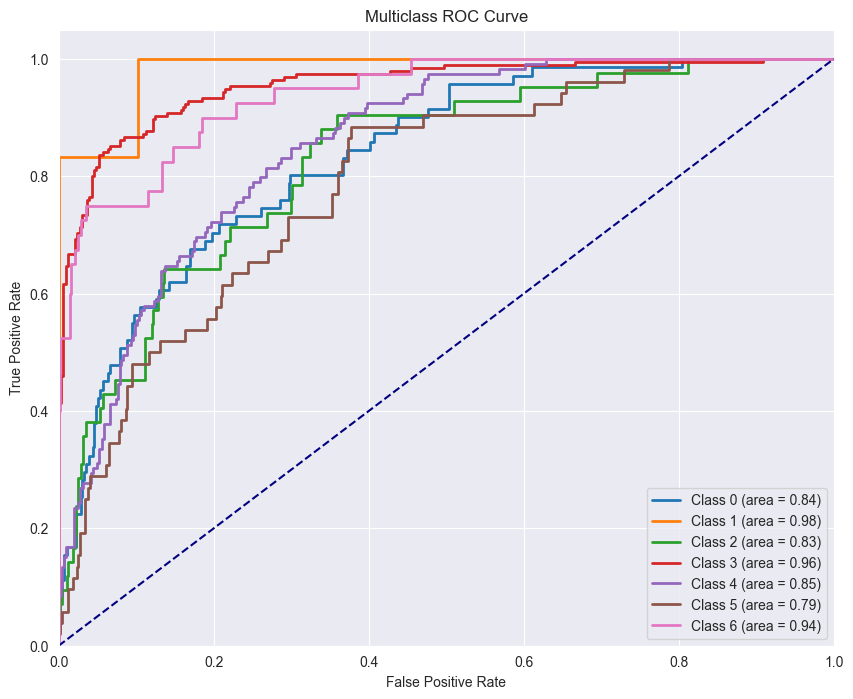

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [92]:
# Assuming y_test_fn is your test labels and svm_clf is your trained classifier
y_prob = mlp_clf.predict_proba(X_test_vgg)
y_bin = label_binarize(y_test_vgg, classes=[0, 1, 2, 3, 4, 5, 6])
n_classes = y_bin.shape[1]

# Compute ROC curve and ROC area for each class
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plotting
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label='Class {} (area = {:.2f})'.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curve')
plt.legend(loc='lower right')
plt.show()

print(label_mapping)

#### 6.2.3 Evaluation Metrics

In [98]:
train_accuracy = accuracy_score(y_train_vgg, y_predicted_train_mlp)
train_precision = precision_score(y_train_vgg, y_predicted_train_mlp, average='macro')
train_recall = recall_score(y_train_vgg, y_predicted_train_mlp, average='macro')
train_f1_score = f1_score(y_train_vgg, y_predicted_train_mlp, average='macro')

print("Training Accuracy:", train_accuracy)
print("Training Precision:", train_precision)
print("Training Recall:", train_recall)
print("Training F1 Score:", train_f1_score)

# Test metrics
test_accuracy = accuracy_score(y_test_vgg, y_predicted_test_mlp)
test_precision = precision_score(y_test_vgg, y_predicted_test_mlp, average='macro')
test_recall = recall_score(y_test_vgg, y_predicted_test_mlp, average='macro')
test_f1_score = f1_score(y_test_vgg, y_predicted_test_mlp, average='macro')

print("\nTest Accuracy:", test_accuracy)
print("Test Precision:", test_precision)
print("Test Recall:", test_recall)
print("Test F1 Score:", test_f1_score)

Training Accuracy: 0.9985
Training Precision: 0.9982498126908065
Training Recall: 0.9971821866231804
Training F1 Score: 0.9977087385520876

Test Accuracy: 0.6520912547528517
Test Precision: 0.6314089749356155
Test Recall: 0.5884914033714399
Test F1 Score: 0.6046189240228909


#### 6.2.4 Confusion matrix

<Figure size 1000x800 with 0 Axes>

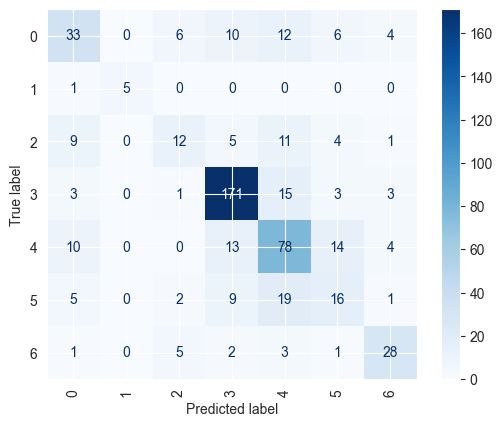

In [106]:
# Make sure confusion_matrix is the function from sklearn.metrics
cm_mlp = confusion_matrix(y_test_vgg, y_predicted_mlp, labels=mlp_clf.classes_)
disp_mlp = ConfusionMatrixDisplay(confusion_matrix=cm_mlp, display_labels=mlp_clf.classes_)

# Increase figure size for better clarity
plt.figure(figsize=(10, 8))

# Use a larger fontsize to make sure text is readable, but adjust according to your needs
disp_mlp.plot(cmap=plt.cm.Blues, xticks_rotation='vertical', values_format='.0f')
plt.show()

#### 6.2.5 Observations

Our fine-tuning of the MLP's hyperparameters, focusing on varying values for activation, alpha, hidden_layer_sizes, learning_rate, and solver which led to the determination that the optimal settings were <b><u>activation= 'relu', alpha= 0.0001, hidden_layer_sizes= (50, 50), learning_rate= 'constant', solver= 'adam'</u></b>. 


<b>Classswise accuracy:</b>
- Class Angry Accuracy: 50.70%
- Class Disgusted Accuracy: 83.33%
- Class Fearful Accuracy: 30.95%
- Class Happy Accuracy: 93.37%
- Class Neutral Accuracy: 68.91%
- Class Sad Accuracy: 25.00%
- Class Surprised Accuracy: 70%

Upon meticulous analysis, it has been ascertained that the Support Vector Machine (SVM) exhibits superior performance compared to the Multilayer Perceptron (MLP) when gauged by accuracy, albeit with a modest enhancement of 3%. A detailed inspection of the confusion matrix reveals a consistent pattern of misclassification across both models. The specific classes that were prone to misidentification in the initial model persist in displaying similar tendencies in the subsequent SVM model, suggesting that certain inherent challenges in distinguishing between these classes remain unaddressed by the transition to a different algorithmic approach.

### 6.3 MLP with FaceNet reps

#### 6.3.1 Training with MLP

In [99]:
mlp_fn_clf = MLPClassifier(hidden_layer_sizes=(100,50), alpha=0.0001, activation='relu', 
                        solver='adam', learning_rate='constant',
                        max_iter=1000).fit(X_train_fn, y_train_fn)

In [119]:
y_predicted_train_mlp_fn = mlp_fn_clf.predict(X_train_fn)

In [120]:
y_predicted_test_mlp_fn = mlp_fn_clf.predict(X_test_fn)

#### 6.3.2 RoC curve

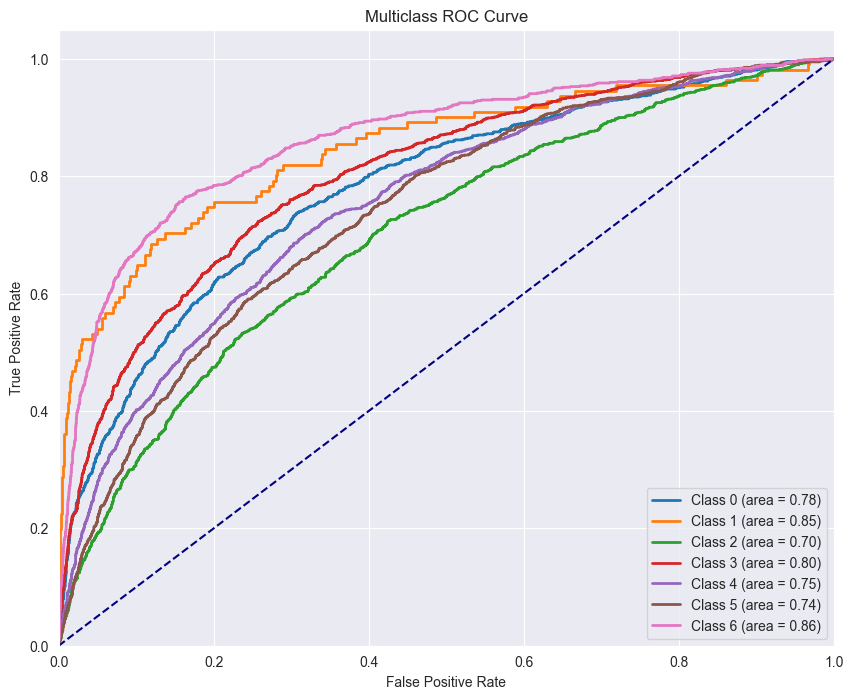

{'  angry': 0, '  disgusted': 1, '  fearful': 2, '  happy': 3, '  neutral': 4, '  sad': 5, '  surprised': 6}


In [121]:
# Assuming y_test_fn is your test labels and svm_clf is your trained classifier
y_prob = mlp_fn_clf.predict_proba(X_test_fn)
y_bin = label_binarize(y_test_fn, classes=[0, 1, 2, 3, 4, 5, 6])
n_classes = y_bin.shape[1]

# Compute ROC curve and ROC area for each class
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plotting
plt.figure(figsize=(10, 8))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], lw=2, label='Class {} (area = {:.2f})'.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curve')
plt.legend(loc='lower right')
plt.show()

print(label_mapping)

#### 6.3.3 Evaluation metrics

In [122]:
train_accuracy = accuracy_score(y_train_fn, y_predicted_train_mlp_fn)
train_precision = precision_score(y_train_fn, y_predicted_train_mlp_fn, average='macro')
train_recall = recall_score(y_train_fn, y_predicted_train_mlp_fn, average='macro')
train_f1_score = f1_score(y_train_fn, y_predicted_train_mlp_fn, average='macro')

print("Training Accuracy:", train_accuracy)
print("Training Precision:", train_precision)
print("Training Recall:", train_recall)
print("Training F1 Score:", train_f1_score)

# Test metrics
test_accuracy = accuracy_score(y_test_fn, y_predicted_test_mlp_fn)
test_precision = precision_score(y_test_fn, y_predicted_test_mlp_fn, average='macro')
test_recall = recall_score(y_test_fn, y_predicted_test_mlp_fn, average='macro')
test_f1_score = f1_score(y_test_fn, y_predicted_test_mlp_fn, average='macro')

print("\nTest Accuracy:", test_accuracy)
print("Test Precision:", test_precision)
print("Test Recall:", test_recall)
print("Test F1 Score:", test_f1_score)

Training Accuracy: 0.6986659235779721
Training Precision: 0.7190064372120993
Training Recall: 0.7110942779457938
Training F1 Score: 0.7123763589462069

Test Accuracy: 0.45695179715798273
Test Precision: 0.42873389963478176
Test Recall: 0.4479690912662839
Test F1 Score: 0.436093106924696


#### 6.3.4 Confusion matrix

<Figure size 1000x800 with 0 Axes>

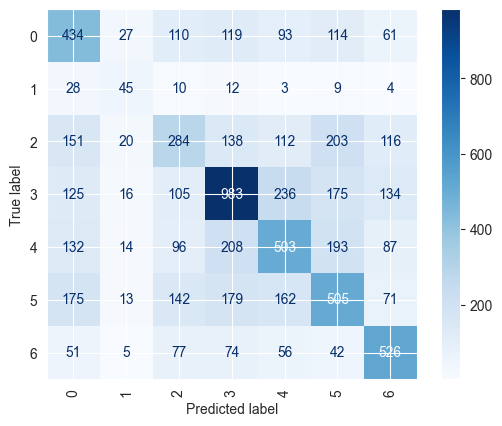

In [123]:
# Make sure confusion_matrix is the function from sklearn.metrics
cm_mlp_fn = confusion_matrix(y_test_fn, y_predicted_test_mlp_fn, labels=mlp_fn_clf.classes_)
disp_mlp_fn = ConfusionMatrixDisplay(confusion_matrix=cm_mlp_fn, display_labels=mlp_fn_clf.classes_)

# Increase figure size for better clarity
plt.figure(figsize=(10, 8))

# Use a larger fontsize to make sure text is readable, but adjust according to your needs
disp_mlp_fn.plot(cmap=plt.cm.Blues, xticks_rotation='vertical', values_format='.0f')
plt.show()

#### 6.3.5 Observations

Leveraging the optimal parameters obtained from hyperparameter tuning for VGG representations—specifically, an activation function of 'relu', an alpha value of 0.0001, hidden layer sizes of (50, 50), a constant learning rate, and the 'adam' solver—we applied the same settings to the FaceNet representations.

<b>Classswise accuracy:</b>
- Class Angry Accuracy: 45%
- Class Disgusted Accuracy: 41%
- Class Fearful Accuracy: 28%
- Class Happy Accuracy: 55%
- Class Neutral Accuracy: 41%
- Class Sad Accuracy: 40%
- Class Surprised Accuracy: 63%

Our analysis indicates a recurring outcome analogous to previous findings. The Support Vector Machine (SVM) outshines the Multilayer Perceptron (MLP) in training efficiency. Scrutinizing the confusion matrix, we discerned a persistent misclassification trend that echoes the patterns seen in prior models. This suggests that the specific classes susceptible to confusion remain similarly challenging to distinguish, even when adopting a varied computational strategy. The data points to underlying complexities in the feature space that both models grapple with, suggesting a need for further refinement in the approach to class differentiation.

## 7. Conclusion

- Through our research and rigorous testing, we have identified that the pinnacle of accuracy on our test dataset peaks at 68%. The model that stands out as the most proficient is the Support Vector Machine (SVM), paired with the feature representations derived from VGG embeddings. This combination has proven to be the most effective at capturing the nuances necessary for high performance.

- Interestingly, Principal Component Analysis (PCA) did not align with our expectations as a beneficial tool for this particular scenario. It appears that PCA, in its standard form, might not be well-suited to condense the complexity of our feature space without loss of critical information. Therefore, our future endeavors should pivot towards exploring advanced iterations or alternatives to PCA. Delving into modified versions of PCA may unravel more suitable methods for dimensionality reduction that could enhance our model's ability to discriminate effectively.

### 7.1 Future scope

Looking forward, there's a scope to experiment beyond the confines of FaceNet and VGG architectures. There exists a plethora of other models that could potentially offer superior results, and our next steps could involve evaluating a broader spectrum of these options. Moreover, a balanced dataset, one that presents a more equitable distribution of classes, could be instrumental in achieving a more refined and accurate classification. Adjusting our dataset to address class imbalances may lead to a substantial improvement in our model's ability to generalize and perform more consistently across diverse sets of data.